<a href="https://colab.research.google.com/github/samuhin/TimeSeries/blob/main/TimeSeries.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Установка и импортирование библиотек

##Устанавливаем нестандартные библиотеки

###Библиотека для работы с котировками

In [ ]:
!pip install yfinance

###Библиотека для работы с метриками

In [ ]:
!pip install ml_metrics

##Импортируем основные библиотеки

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import yfinance
from matplotlib import pyplot
from pandas import read_csv
from pandas import DataFrame
from pandas import concat
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error
from keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau
from keras.models import Sequential
from keras.layers import Dense, Flatten, Conv2D, MaxPooling2D, Dropout
from keras.layers import LSTM
from keras.layers import GRU
from keras.layers import SimpleRNN
from sklearn.linear_model import LinearRegression

##Конфигурация для получения изображений высокой чёткости

In [ ]:
%config InlineBackend.figure_format = 'retina'

#Загрузка данных и предобработка данных

##Загрузка

Выбираем временной промежуток

In [ ]:
start_date = '2017-01-01'
end_date = '2020-12-31'

Загружаем данные

In [ ]:
 data = yfinance.download("AUDUSD=X CADUSD=X CHFUSD=X \
                          CNYUSD=X DKKUSD=X EURUSD=X \
                          GBPUSD=X HKDUSD=X JPYUSD=X \
                          KZTUSD=X NOKUSD=X NZDUSD=X \
                          PLNUSD=X RUBUSD=X SEKUSD=X",
                        start=start_date, end=end_date)

[*********************100%***********************]  15 of 15 completed


Посмотрим на скачанные данные (закрытие)

In [ ]:
 data['Close'].head()

,AUDUSD=X,CADUSD=X,CHFUSD=X,CNYUSD=X,DKKUSD=X,EURUSD=X,GBPUSD=X,HKDUSD=X,JPYUSD=X,KZTUSD=X,NOKUSD=X,NZDUSD=X,PLNUSD=X,RUBUSD=X,SEKUSD=X
Date,,,,,,,,,,,,,,,
2017-01-02,0.720981,0.744380,0.981653,0.144013,0.141589,1.052698,1.234903,0.128949,0.008562,0.003012,0.115845,0.693433,0.239261,0.016332,0.110110
2017-01-03,0.719683,0.743970,0.976381,0.144009,0.140689,1.046003,1.228199,0.128901,0.008511,0.003022,0.115547,0.693193,0.237208,0.016332,0.109632
2017-01-04,0.722993,0.745057,0.974564,0.143682,0.140155,1.041992,1.224560,0.128927,0.008499,0.003028,0.115737,0.692377,0.237595,0.016414,0.109269
2017-01-05,0.728704,0.751936,0.980277,0.144402,0.141231,1.050089,1.232681,0.128950,0.008539,0.003036,0.116524,0.696330,0.240393,0.016566,0.109964
2017-01-06,0.733837,0.755892,0.990305,0.145182,0.142680,1.060592,1.242545,0.128959,0.008676,0.003062,0.117927,0.702149,0.243142,0.016835,0.111151


Посмотрим описание данных

In [ ]:
 data['Close'].describe()

,AUDUSD=X,CADUSD=X,CHFUSD=X,CNYUSD=X,DKKUSD=X,EURUSD=X,GBPUSD=X,HKDUSD=X,JPYUSD=X,KZTUSD=X,NOKUSD=X,NZDUSD=X,PLNUSD=X,RUBUSD=X,SEKUSD=X
count,1021.000000,1021.000000,1021.000000,1020.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000
mean,0.725972,0.760871,1.028447,0.147448,0.153501,1.144000,1.297346,0.128135,0.009128,0.002769,0.116271,0.679164,0.265455,0.015635,0.112031
std,0.042692,0.022069,0.033005,0.004888,0.006193,0.045590,0.046177,0.000614,0.000233,0.000281,0.007867,0.034528,0.013252,0.001421,0.006710
min,0.574290,0.689741,0.974564,0.139315,0.140155,1.041992,1.149439,0.127369,0.008499,0.002201,0.085035,0.562610,0.233536,0.012358,0.095797
25%,0.697204,0.749176,1.005429,0.144161,0.149027,1.112929,1.268875,0.127514,0.008950,0.002592,0.111079,0.657138,0.258160,0.014896,0.106778
50%,0.723589,0.759359,1.019056,0.145966,0.152488,1.137540,1.296512,0.128008,0.009113,0.002679,0.116989,0.678509,0.264643,0.015673,0.111624
75%,0.758743,0.772917,1.040139,0.150578,0.158213,1.177745,1.320795,0.128810,0.009298,0.003037,0.122119,0.704072,0.272327,0.016909,0.115864
max,0.811688,0.825948,1.134327,0.159551,0.168059,1.251001,1.434206,0.129039,0.009698,0.003263,0.130875,0.752570,0.301181,0.017976,0.127521


##Предобработка

Заполним пропуски в данных

In [ ]:
 new_data = data['Close'].interpolate(method='polynomial', order=3)

Посмотрим на результаты заполнения

In [ ]:
 new_data.describe()

,AUDUSD=X,CADUSD=X,CHFUSD=X,CNYUSD=X,DKKUSD=X,EURUSD=X,GBPUSD=X,HKDUSD=X,JPYUSD=X,KZTUSD=X,NOKUSD=X,NZDUSD=X,PLNUSD=X,RUBUSD=X,SEKUSD=X
count,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000
mean,0.725972,0.760871,1.028447,0.147444,0.153501,1.144000,1.297346,0.128135,0.009128,0.002769,0.116271,0.679164,0.265455,0.015635,0.112031
std,0.042692,0.022069,0.033005,0.004888,0.006193,0.045590,0.046177,0.000614,0.000233,0.000281,0.007867,0.034528,0.013252,0.001421,0.006710
min,0.574290,0.689741,0.974564,0.139315,0.140155,1.041992,1.149439,0.127369,0.008499,0.002201,0.085035,0.562610,0.233536,0.012358,0.095797
25%,0.697204,0.749176,1.005429,0.144161,0.149027,1.112929,1.268875,0.127514,0.008950,0.002592,0.111079,0.657138,0.258160,0.014896,0.106778
50%,0.723589,0.759359,1.019056,0.145964,0.152488,1.137540,1.296512,0.128008,0.009113,0.002679,0.116989,0.678509,0.264643,0.015673,0.111624
75%,0.758743,0.772917,1.040139,0.150577,0.158213,1.177745,1.320795,0.128810,0.009298,0.003037,0.122119,0.704072,0.272327,0.016909,0.115864
max,0.811688,0.825948,1.134327,0.159551,0.168059,1.251001,1.434206,0.129039,0.009698,0.003263,0.130875,0.752570,0.301181,0.017976,0.127521


#Подготовка к анализу данных как временного ряда

Напишем функция для преобразование данных в удобную форму для работы с ними

In [ ]:
# convert series to supervised learning
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):
	n_vars = 1 if type(data) is list else data.shape[1]
	df = DataFrame(data)
	cols, names = list(), list()
	# input sequence (t-n, ... t-1)
	for i in range(n_in, 0, -1):
		cols.append(df.shift(i))
		names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
	# forecast sequence (t, t+1, ... t+n)
	for i in range(0, n_out):
		cols.append(df.shift(-i))
		if i == 0:
			names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
		else:
			names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
	# put it all together
	agg = concat(cols, axis=1)
	agg.columns = names
	# drop rows with NaN values
	if dropnan:
		agg.dropna(inplace=True)
	return agg

Введём дополнительные регрессоры (если нужно)

In [ ]:
#new_data['day'] = new_data.index.day
#new_data['month'] = new_data.index.month

Переведём данные в numpy-массив:

In [ ]:
values = new_data.values
values

array([[0.72098053, 0.74437994, 0.98165292, ..., 0.23926078, 0.01633152,
        0.11011021],
       [0.71968335, 0.7439701 , 0.97638136, ..., 0.23720796, 0.01633232,
        0.1096323 ],
       [0.7229926 , 0.74505657, 0.97456384, ..., 0.2375946 , 0.01641416,
        0.10926872],
       ...,
       [0.7588923 , 0.77881616, 1.12574577, ..., 0.27210575, 0.01352622,
        0.1210579 ],
       [0.76098984, 0.77990347, 1.13109374, ..., 0.26990852, 0.01350961,
        0.12188224],
       [0.76892906, 0.7842707 , 1.13432705, ..., 0.2686179 , 0.01341886,
        0.12211846]])

Посмотрим какая у него размерность

In [ ]:
values.shape 

(1021, 15)

Сделаем преобразование MinMaxScale для данных

In [ ]:
# ensure all data is float
values = values.astype('float32')
# normalize features
scaler = MinMaxScaler(feature_range=(0, 1))
scaled = scaler.fit_transform(values)

Посмотрим что получилось:

In [ ]:
 scaled

array([[0.6179085 , 0.4011469 , 0.04437256, ..., 0.08463311, 0.7072511 ,
        0.45117784],
       [0.6124444 , 0.39813805, 0.01137638, ..., 0.05428648, 0.70739365,
        0.4361136 ],
       [0.626384  , 0.40611458, 0.        , ..., 0.06000233, 0.7219608 ,
        0.4246533 ],
       ...,
       [0.77760553, 0.6539693 , 0.94628763, ..., 0.57017875, 0.20794702,
        0.796262  ],
       [0.7864411 , 0.661952  , 0.9797621 , ..., 0.5376971 , 0.20499039,
        0.8222463 ],
       [0.8198838 , 0.6940155 , 1.        , ..., 0.5186181 , 0.18883777,
        0.8296921 ]], dtype=float32)

#Разделение выборки на обучающую, тестовую и валидационную

Посмотрим сколько у нас всего единиц времени

In [ ]:
len(values)

1021

Настроим параметры и поделим

In [ ]:
def split(n_previous, n_predict, train_per, val_per):
  # specify the number of lag hours
  n_hours = n_previous
  n_features = scaled.shape[1]
  n_predict = n_predict

  # frame as supervised learning
  reframed = series_to_supervised(scaled, n_hours, n_predict)

  # split into train and test sets
  values = reframed.values

  n_train_hours = int(len(values) * train_per)
  n_val_hours = int(len(values) * val_per)

  train = values[:n_train_hours, :]
  test = values[n_train_hours:-n_val_hours, :]
  valid = values[-n_val_hours:, :]

  # split into input and outputs
  n_obs = n_hours * n_features
  train_X, train_y = train[:, :n_obs], train[:, n_obs:]
  test_X, test_y = test[:, :n_obs], test[:, n_obs:]
  valid_X, valid_y = valid[:, :n_obs], valid[:, n_obs:]

  # reshape input to be 3D [samples, timesteps, features]
  train_X = train_X.reshape((train_X.shape[0], n_hours, n_features))
  test_X = test_X.reshape((test_X.shape[0], n_hours, n_features))
  valid_X = valid_X.reshape((valid_X.shape[0], n_hours, n_features))
  return (train_X, test_X, valid_X, train_y, test_y, valid_y)

In [ ]:
train_X, test_X, valid_X, train_y, test_y, valid_y = split(3, 1, 0.6, 0.15)

#Анализ

##Метрики

In [ ]:
import ml_metrics as metrics

###MSE

In [ ]:
def MSE(y_hat, y_pred):
  pass
  return metrics.mse(y_hat, y_pred)

###RMSE

In [ ]:
def RMSE(y_hat, y_pred):
  pass
  return metrics.rmse(y_hat, y_pred)

###MAE

In [ ]:
def MAE(y_hat, y_pred):
  pass
  return metrics.mae(y_hat, y_pred)

##Создаём таблицу результатов

In [ ]:
table = pd.DataFrame()

##Наивный алгоритм

Составляем предсказание

In [ ]:
y_pred = []
i = 0
n = 10

while len(y_pred) < len(test_y):
  temp_pred = test_X[i]
  for j in range(n):
    temp_pred = np.concatenate((temp_pred, np.array([temp_pred[-n:][-1]])))
    y_pred.append(temp_pred[-1])
  i = i + n

Выполяем обратное преобразование

In [ ]:
y_pred = np.array(y_pred)[:len(test_y)]
y_hat = scaler.inverse_transform(test_y)
y_pred = scaler.inverse_transform(y_pred)

Выводим график предсказания

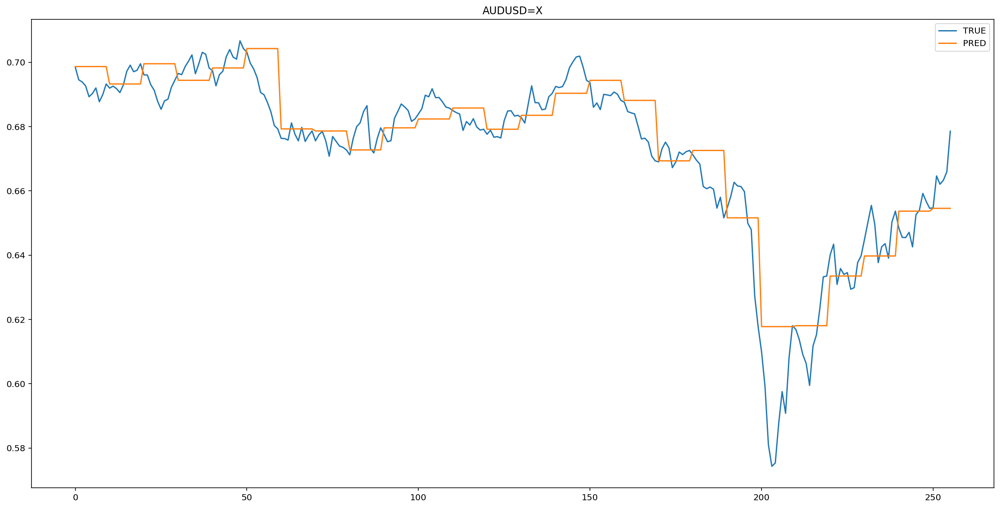

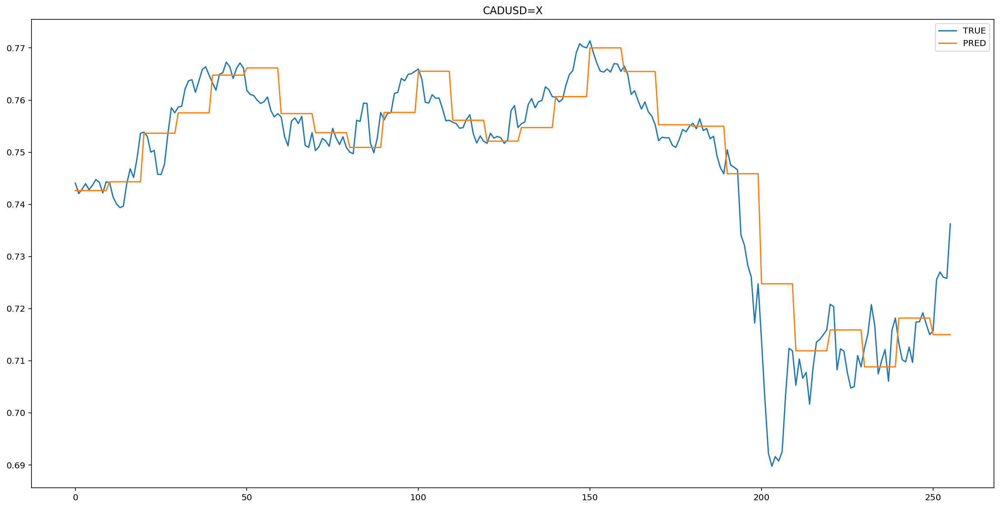

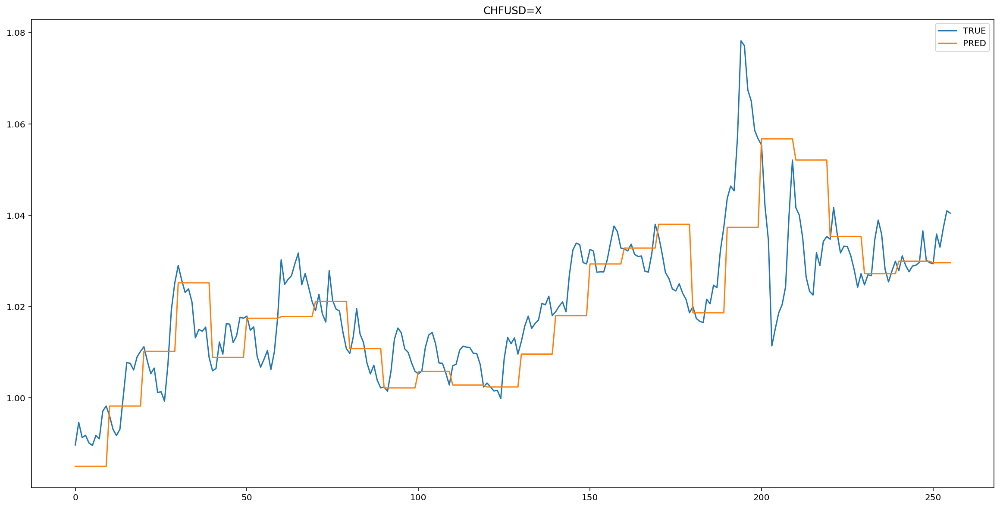

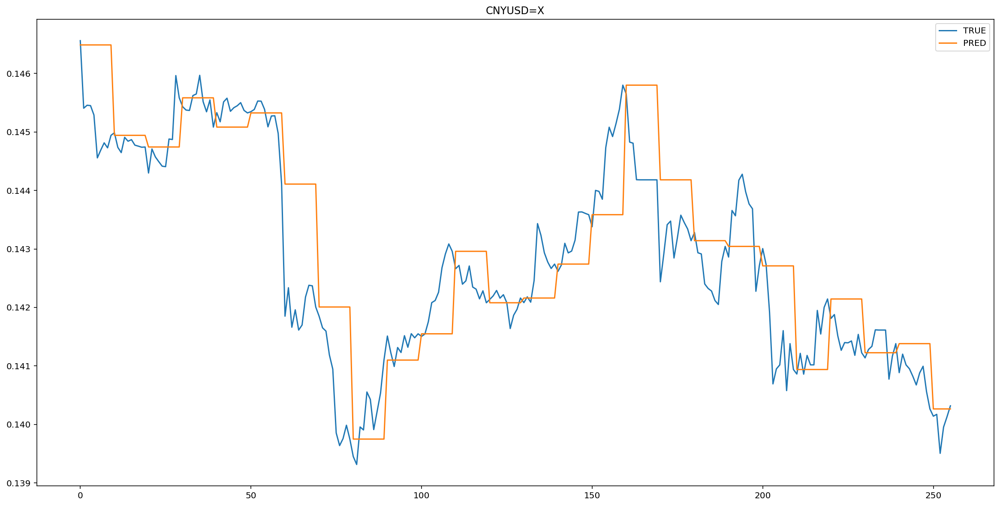

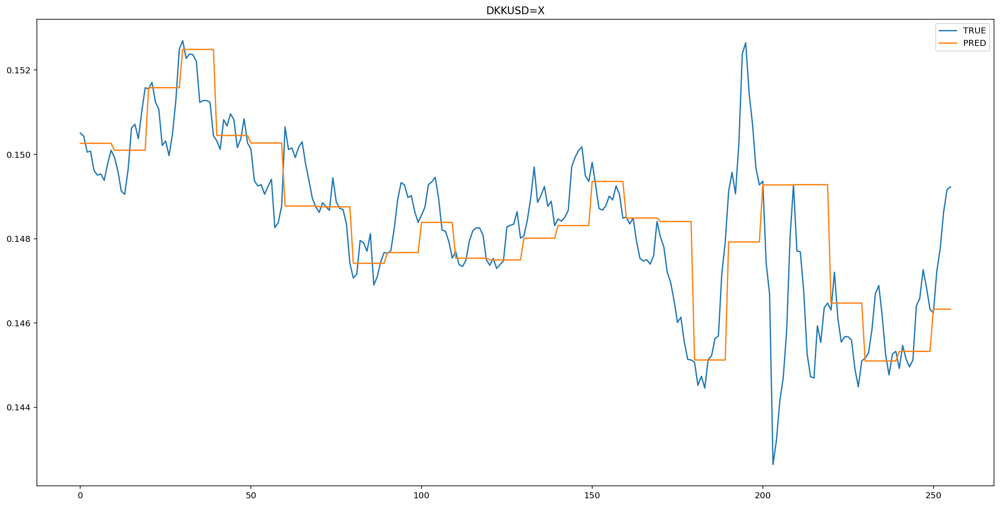

...

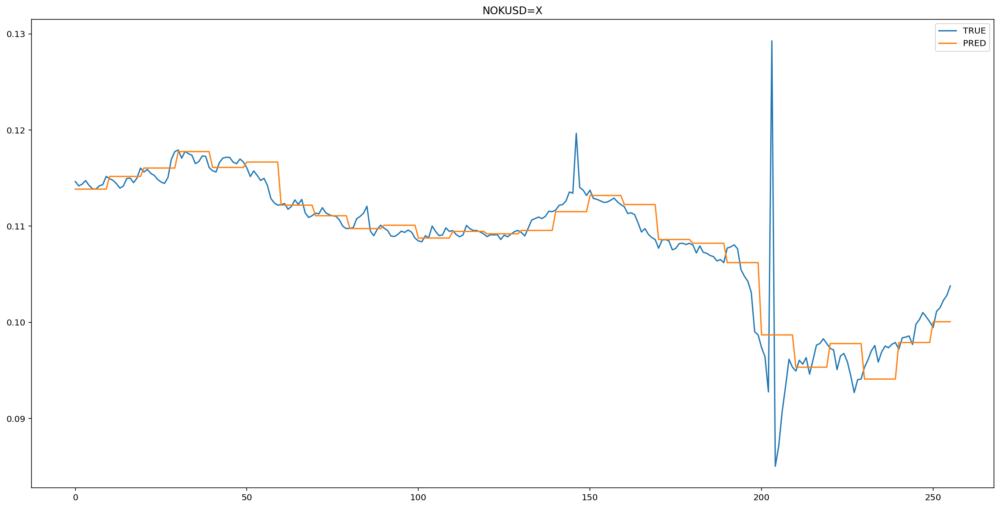

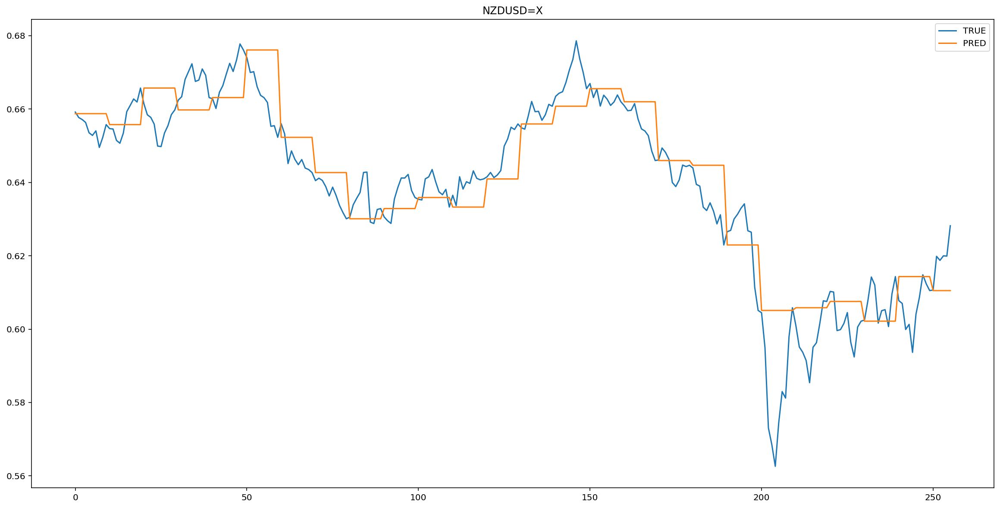

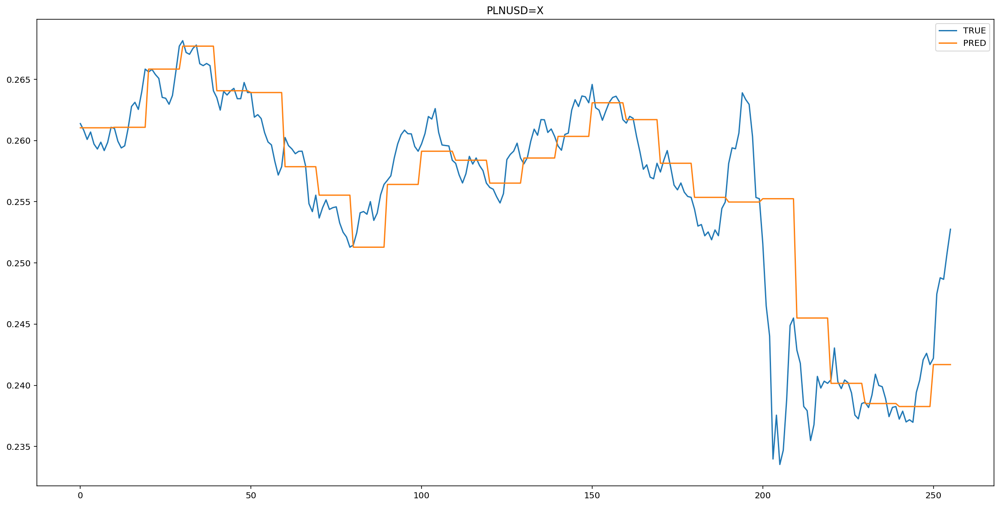

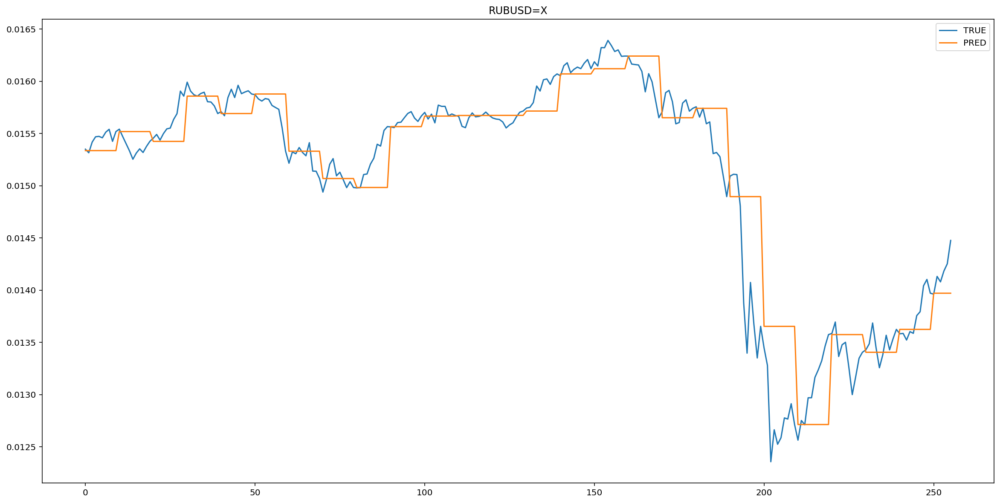

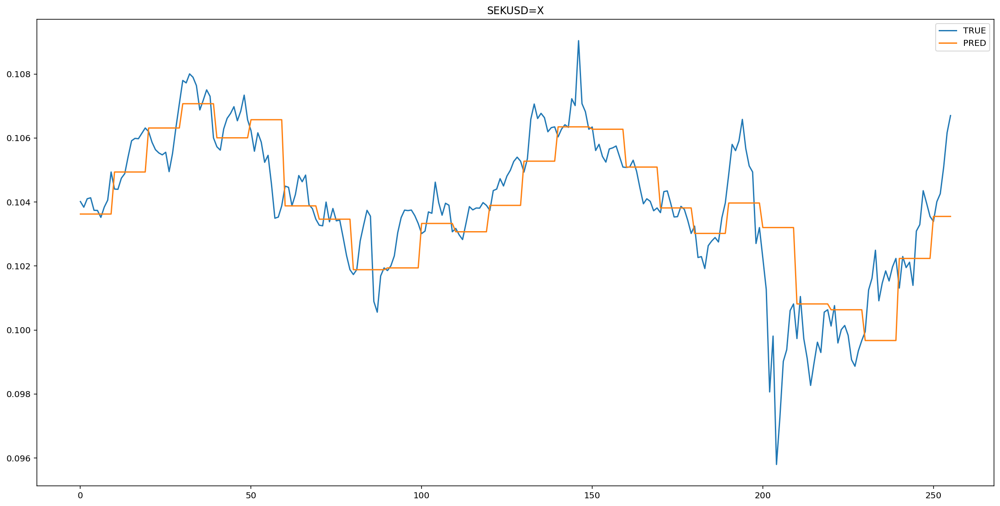

In [ ]:
 for i in range(y_hat.shape[1]):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.title(new_data.columns[i])
    pd.DataFrame(y_hat[:, i],columns=['TRUE']).plot(ax = ax)
    pd.DataFrame(y_pred[:, i],columns=['PRED']).plot(ax = ax)
    plt.show()

###Оцениваем точность

In [ ]:
MSE(y_hat, y_pred)

5.8025744e-05

In [ ]:
RMSE(y_hat, y_pred)

0.007617463

In [ ]:
MAE(y_hat, y_pred)

0.0036440634

##Среднее

###Простое среднее

Составляем предсказание

In [ ]:
y_pred = []
i = 0
n = 10

while len(y_pred) < len(test_y):
  temp_pred = test_X[i]
  for j in range(n):
    temp_pred = np.array([temp_pred[-n:].mean(axis = 0)]) #простое среднее
    y_pred.append(temp_pred[-1])
  i = i + n

Делаем обратное предсказание

In [ ]:
y_pred = np.array(y_pred)[:len(test_y)]
y_hat = scaler.inverse_transform(test_y)
y_pred = scaler.inverse_transform(y_pred)

Выводим графики

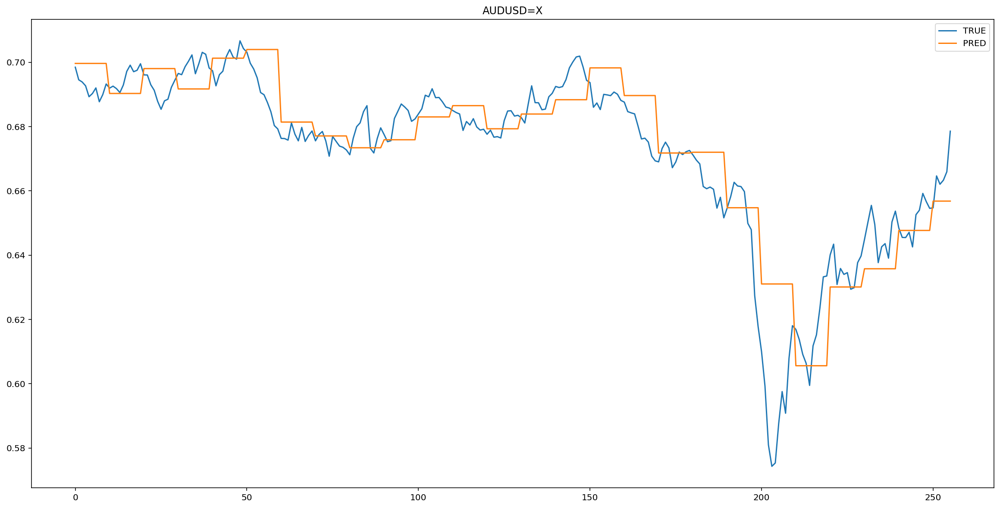

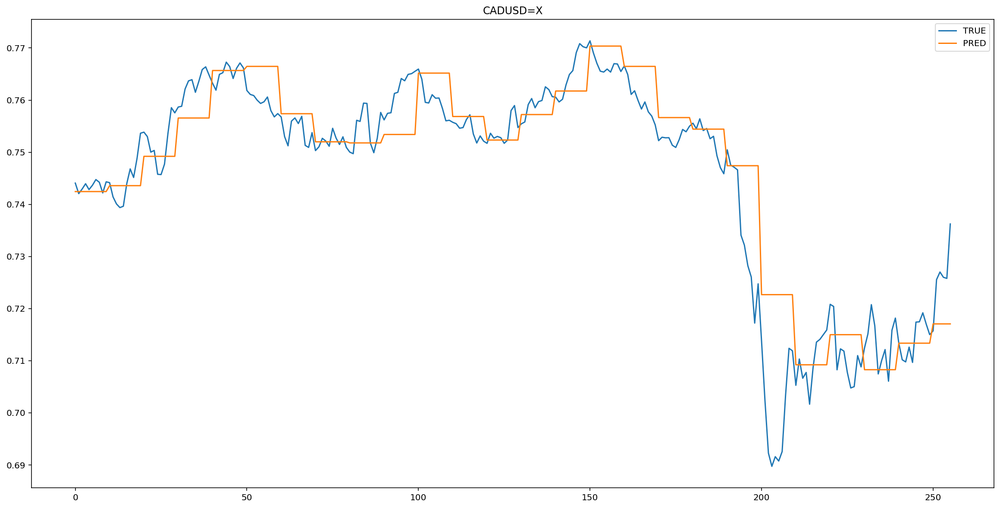

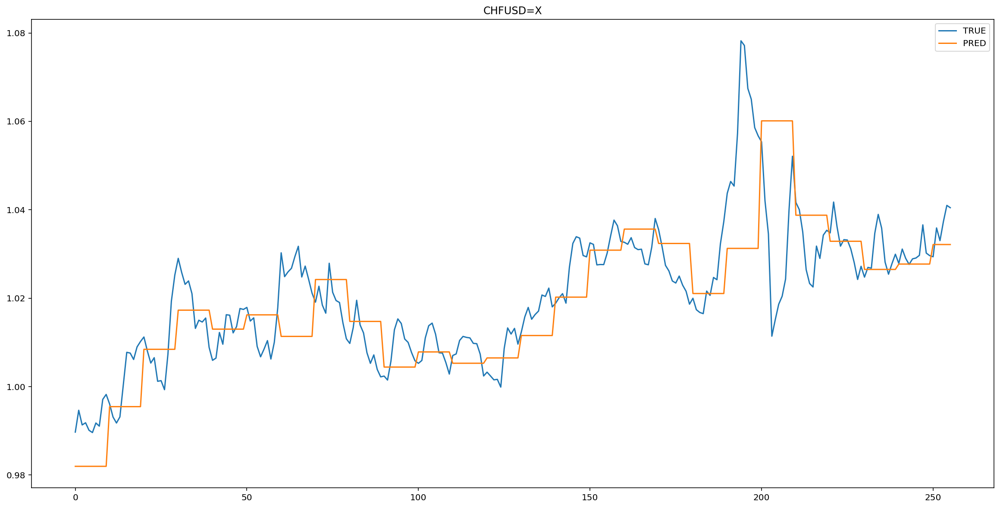

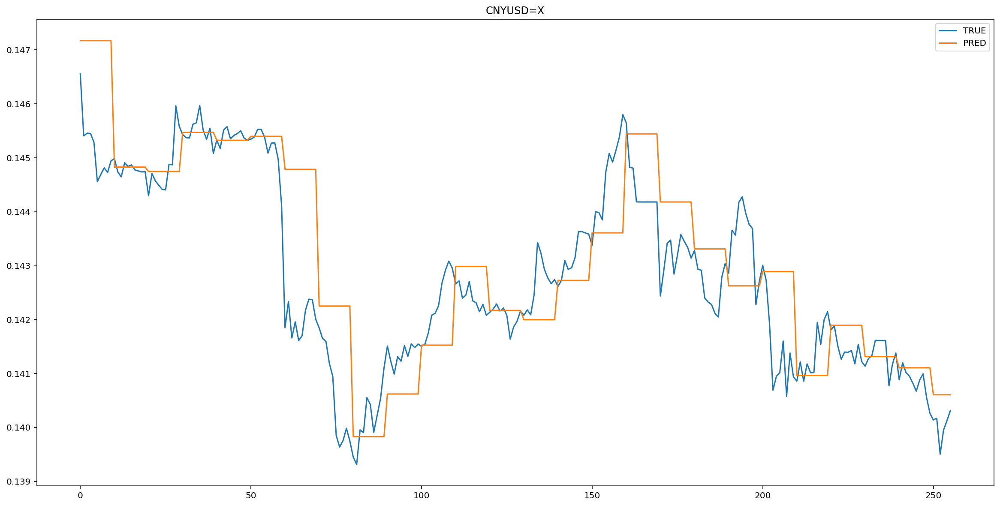

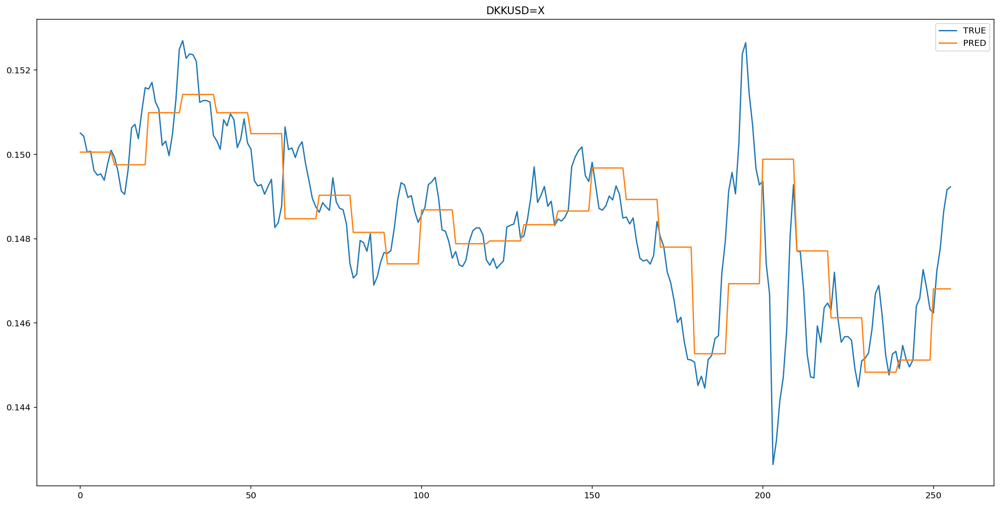

...

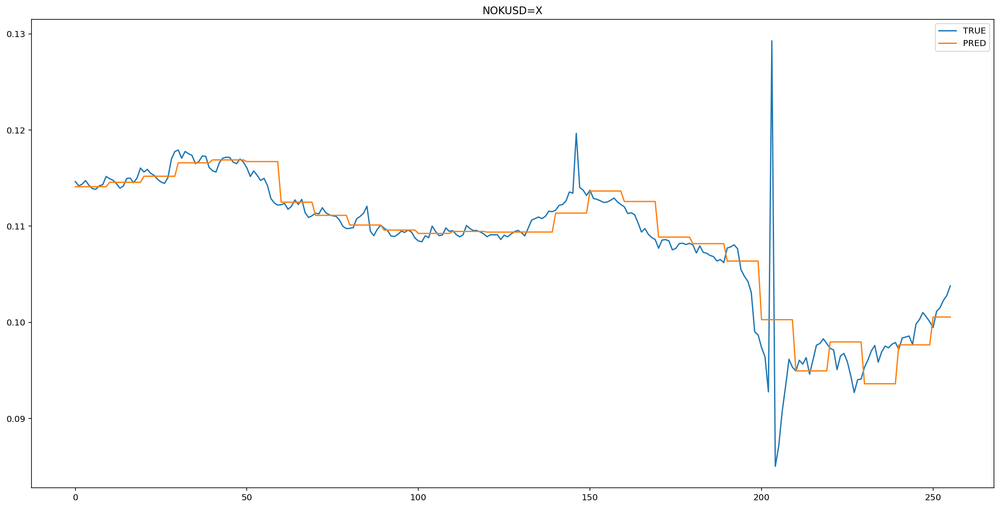

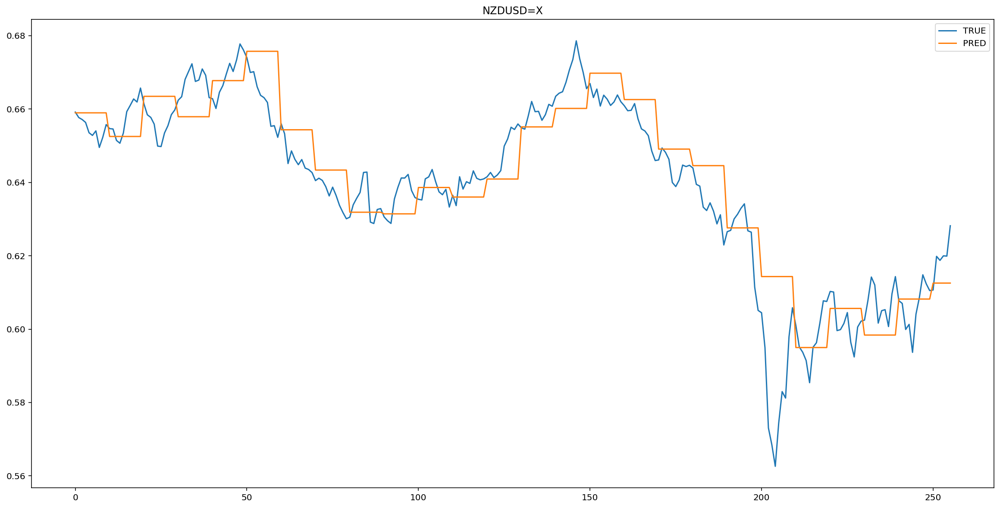

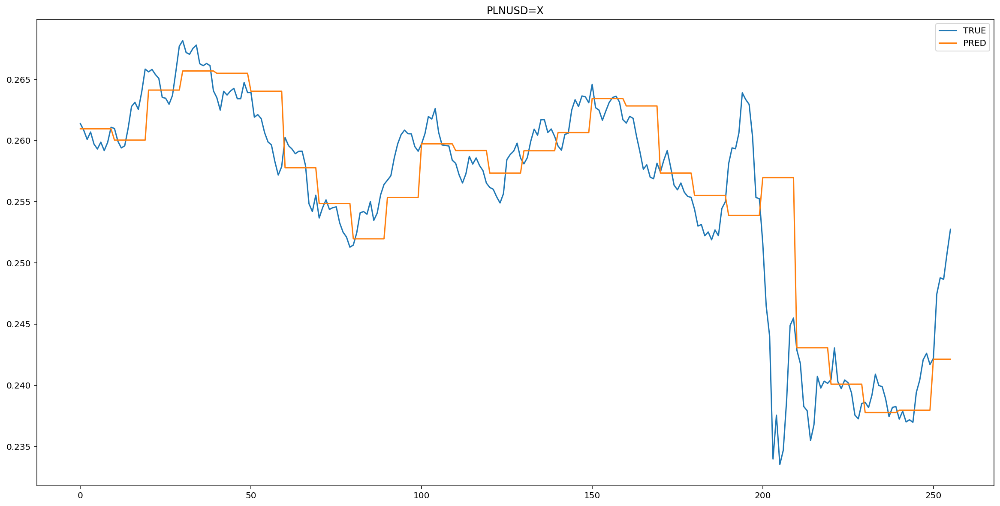

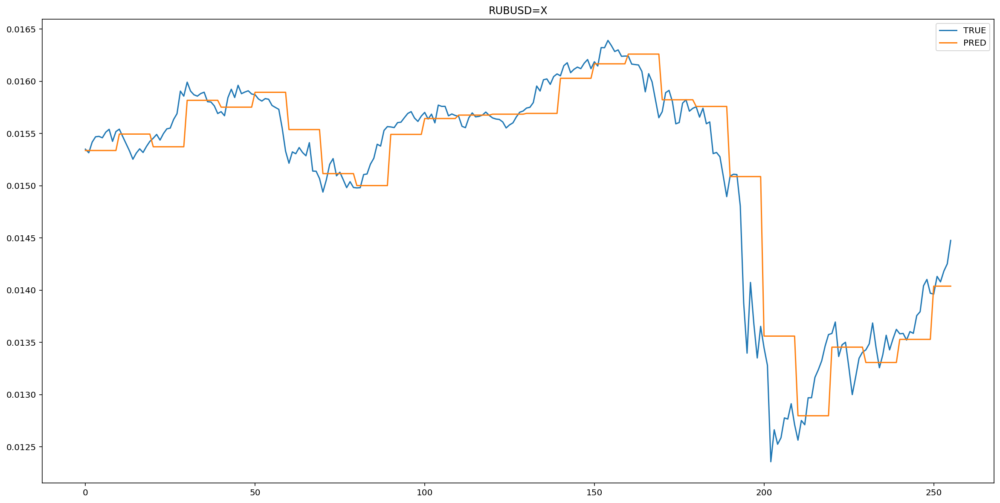

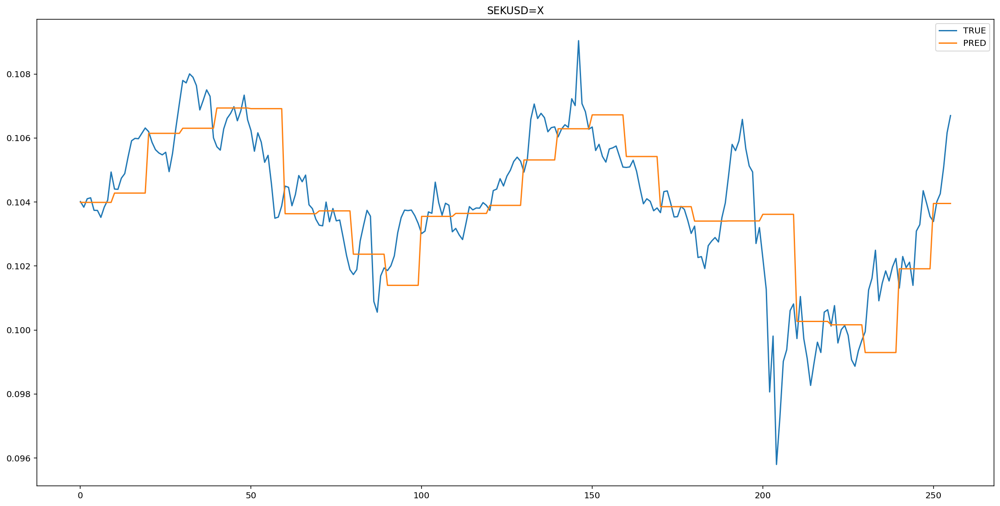

In [ ]:
 for i in range(y_hat.shape[1]):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.title(new_data.columns[i])
    pd.DataFrame(y_hat[:, i],columns=['TRUE']).plot(ax = ax)
    pd.DataFrame(y_pred[:, i],columns=['PRED']).plot(ax = ax)
    plt.show()

####Оцениваем точность

In [ ]:
MSE(y_hat, y_pred)

7.106539e-05

In [ ]:
RMSE(y_hat, y_pred)

0.008430029

In [ ]:
MAE(y_hat, y_pred)

0.0038278026

###Скользящее среднее

Составляем прогноз

In [ ]:
y_pred = []
i = 0
n = 10

while len(y_pred) < len(test_y):
  temp_pred = test_X[i]
  for j in range(n):
    temp_pred = np.concatenate((temp_pred, np.array([temp_pred[-n:].mean(axis = 0)]))) #скользящее среднее
    y_pred.append(temp_pred[-1])
  i = i + n


Делаем обратное преобразование

In [ ]:
y_pred = np.array(y_pred)[:len(test_y)]
y_hat = scaler.inverse_transform(test_y)
y_pred = scaler.inverse_transform(y_pred)

Выводим график

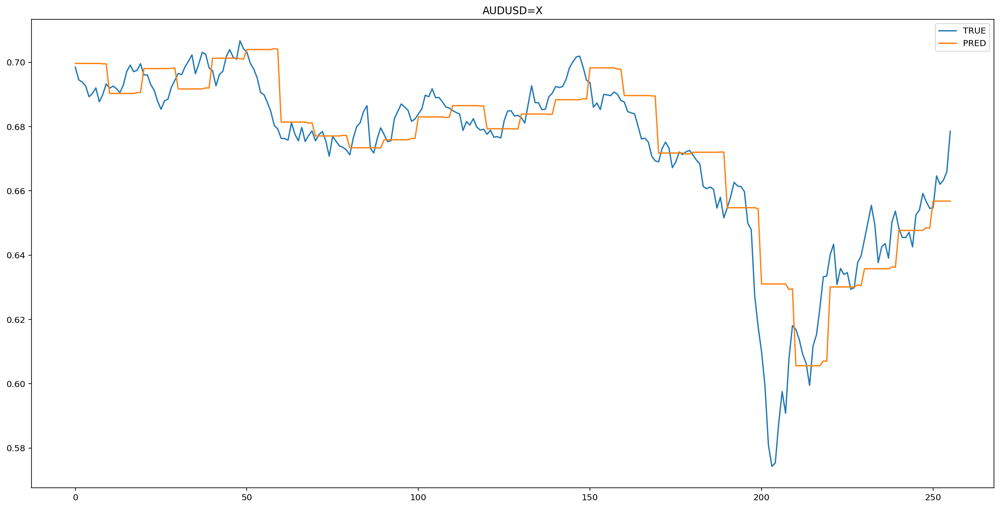

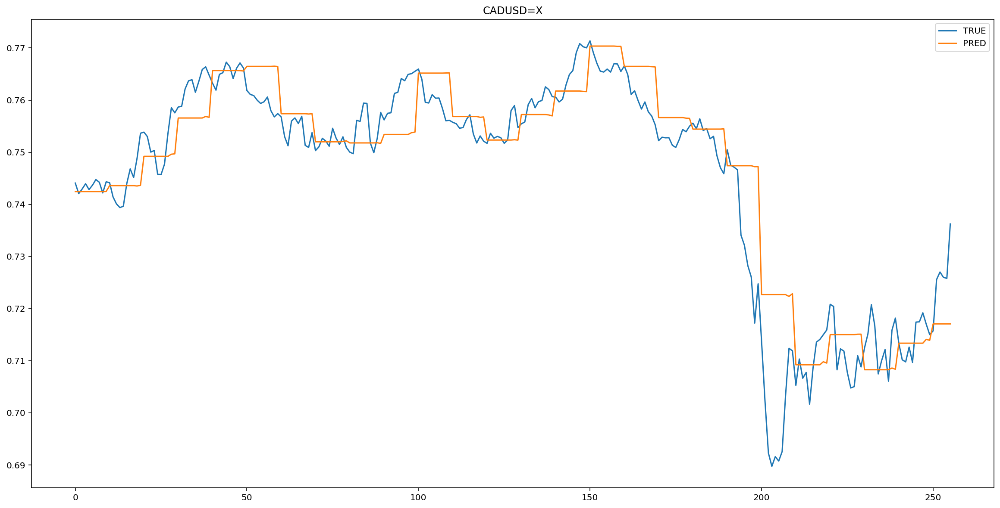

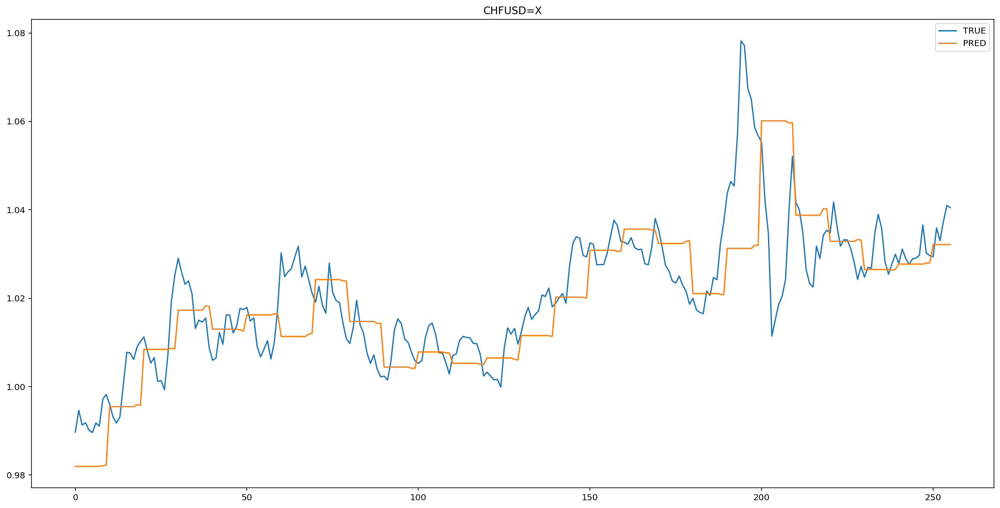

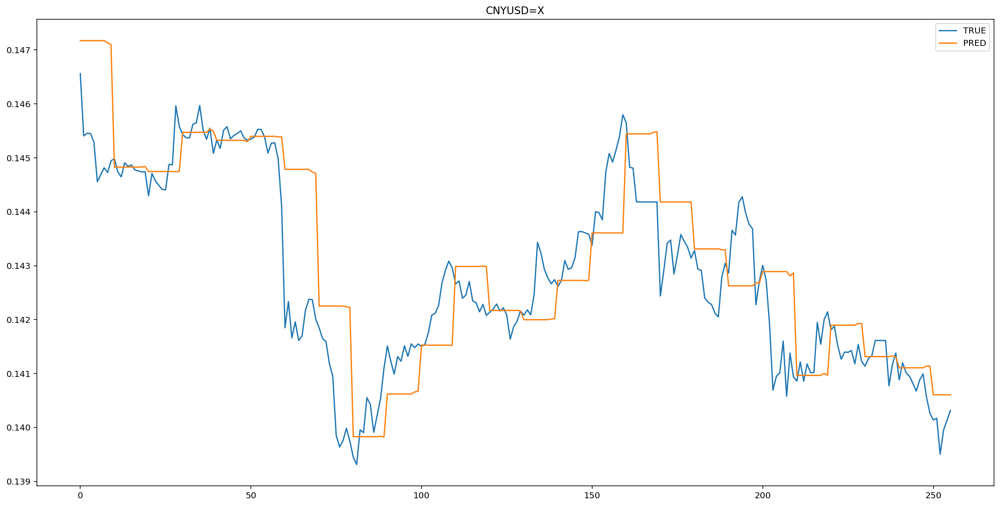

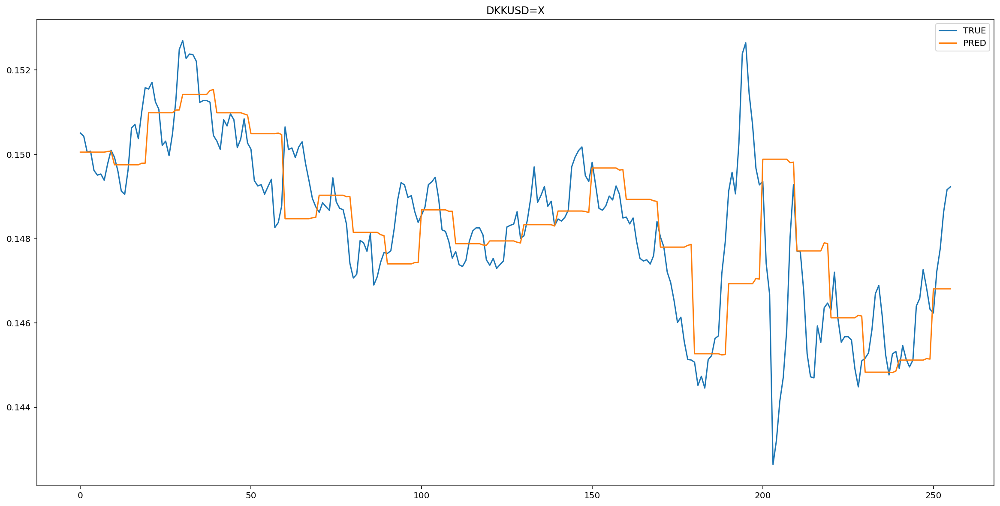

...

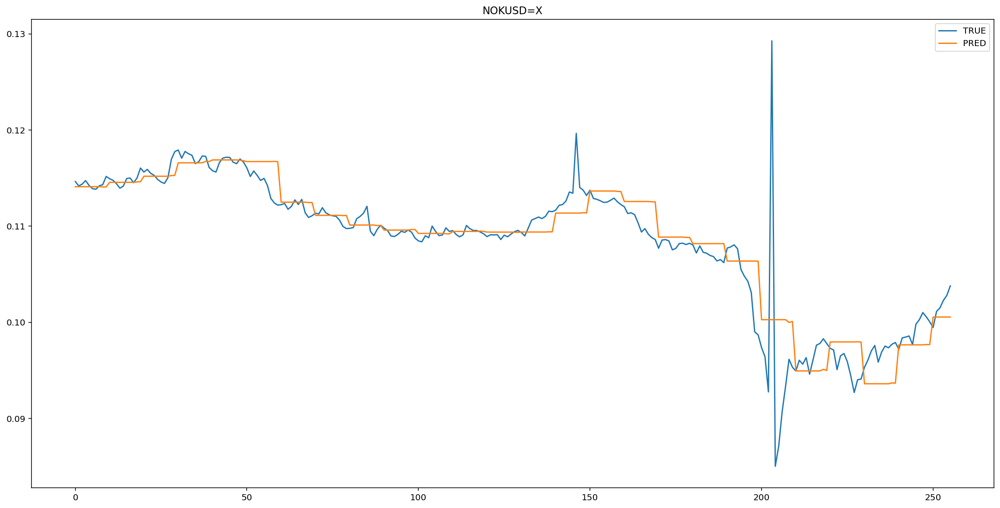

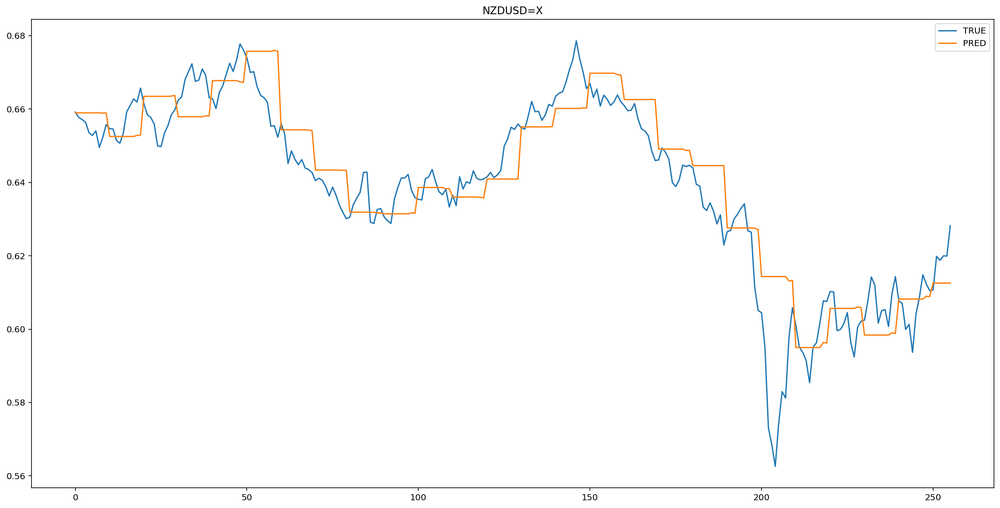

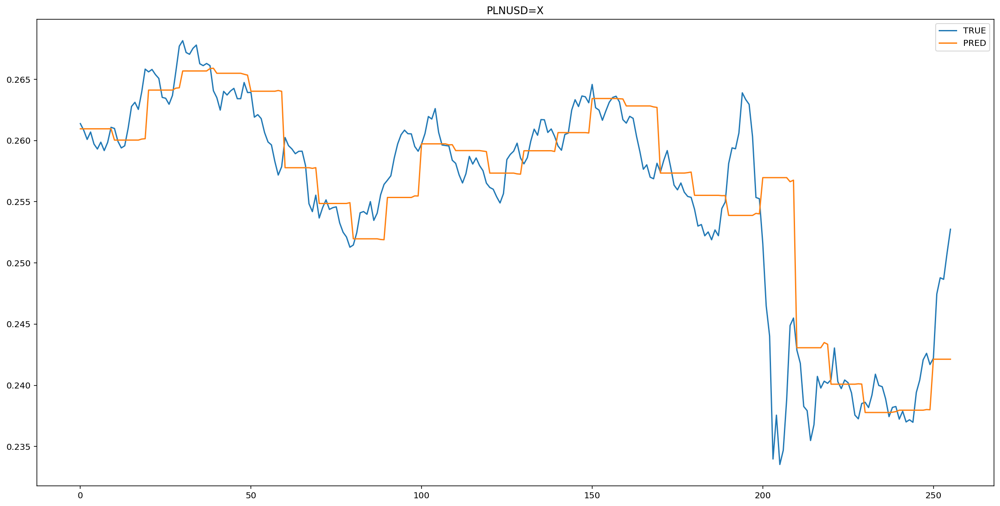

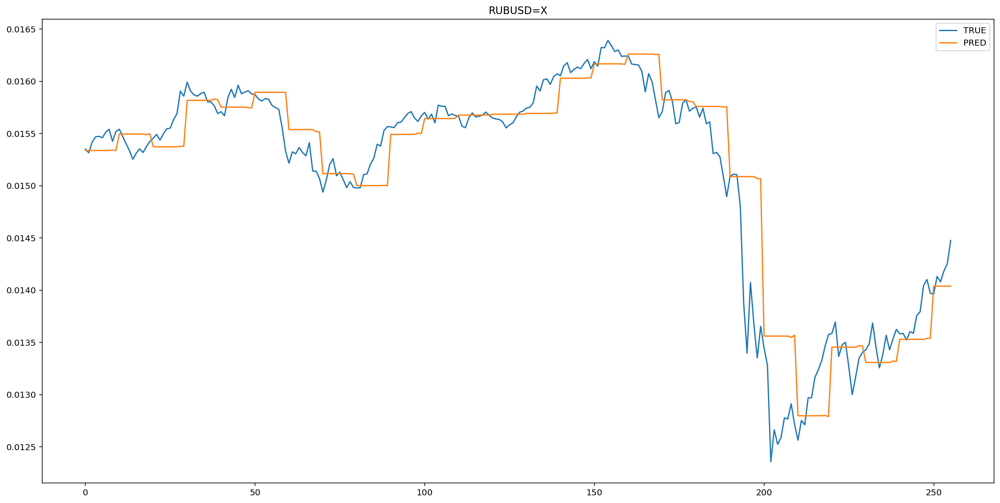

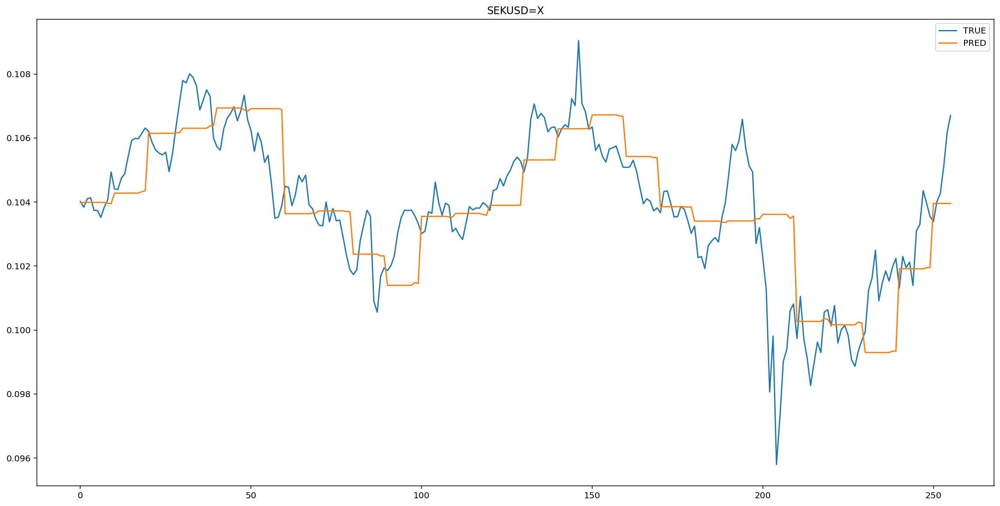

In [ ]:
for i in range(y_hat.shape[1]):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.title(new_data.columns[i])
    pd.DataFrame(y_hat[:, i],columns=['TRUE']).plot(ax = ax)
    pd.DataFrame(y_pred[:, i],columns=['PRED']).plot(ax = ax)
    plt.show()

####Оцениваем точность

In [ ]:
MSE(y_hat, y_pred)

7.0633825e-05

In [ ]:
RMSE(y_hat, y_pred)

0.008404393

In [ ]:
MAE(y_hat, y_pred)

0.0038162828

##Регрессия

Импортируем библиотеки

In [ ]:
from sklearn.linear_model import Ridge, Lasso

###Простая линейная

Строим модель

In [ ]:
linear_model = LinearRegression()
linear_model.fit(train_X.reshape(train_X.shape[0], train_X.shape[1]*train_X.shape[2]), train_y)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

Считаем score

In [ ]:
 linear_model.score(test_X.reshape(test_X.shape[0], test_X.shape[1]*test_X.shape[2]), test_y)

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:434: FutureWarning: The default value of multioutput (not exposed in score method) will change from 'variance_weighted' to 'uniform_average' in 0.23 to keep consistent with 'metrics.r2_score'. To specify the default value manually and avoid the warning, please either call 'metrics.r2_score' directly or make a custom scorer with 'metrics.make_scorer' (the built-in scorer 'r2' uses multioutput='uniform_average').
  "multioutput='uniform_average').", FutureWarning)


0.9140473018607213

###Lasso

Строим модель

In [ ]:
linear_model = Lasso(alpha=0.0001)
linear_model.fit(train_X.reshape(train_X.shape[0], train_X.shape[1]*train_X.shape[2]), train_y)

Lasso(alpha=0.0001, copy_X=True, fit_intercept=True, max_iter=1000,
      normalize=False, positive=False, precompute=False, random_state=None,
      selection='cyclic', tol=0.0001, warm_start=False)

Считаем score

In [ ]:
linear_model.score(test_X.reshape(test_X.shape[0], test_X.shape[1]*test_X.shape[2]), test_y)

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:434: FutureWarning: The default value of multioutput (not exposed in score method) will change from 'variance_weighted' to 'uniform_average' in 0.23 to keep consistent with 'metrics.r2_score'. To specify the default value manually and avoid the warning, please either call 'metrics.r2_score' directly or make a custom scorer with 'metrics.make_scorer' (the built-in scorer 'r2' uses multioutput='uniform_average').
  "multioutput='uniform_average').", FutureWarning)


0.9455366477565754

###Ridge

Строим модель

In [ ]:
linear_model = Ridge(alpha=0.004)
linear_model.fit(train_X.reshape(train_X.shape[0], train_X.shape[1]*train_X.shape[2]), train_y)

Ridge(alpha=0.004, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=None, solver='auto', tol=0.001)

Считаем score

In [ ]:
linear_model.score(test_X.reshape(test_X.shape[0], test_X.shape[1]*test_X.shape[2]), test_y)

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:434: FutureWarning: The default value of multioutput (not exposed in score method) will change from 'variance_weighted' to 'uniform_average' in 0.23 to keep consistent with 'metrics.r2_score'. To specify the default value manually and avoid the warning, please either call 'metrics.r2_score' directly or make a custom scorer with 'metrics.make_scorer' (the built-in scorer 'r2' uses multioutput='uniform_average').
  "multioutput='uniform_average').", FutureWarning)


0.9190165073227986

##ARIMA

###ARIMA

###SARIMAX

###VAR

In [ ]:
from statsmodels.tsa.api import VAR 

/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [ ]:
model = VAR(train_y)

In [ ]:
results = model.fit(ic='aic') 

In [ ]:
y_pred = []

for i in range(len(test_X)):
  y_pred.append(results.forecast(test_X[i], 1)[0])
y_pred = scaler.inverse_transform(np.array(y_pred))
y_hat = scaler.inverse_transform(test_y)

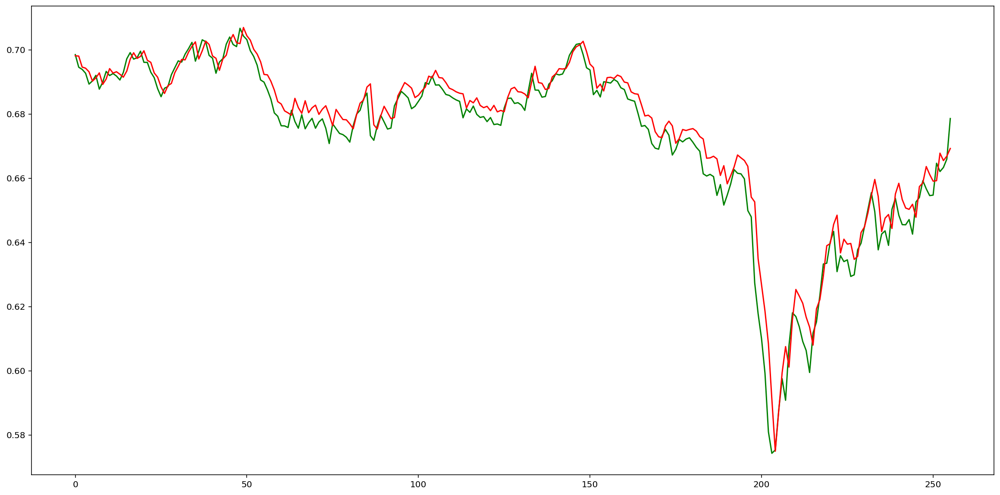

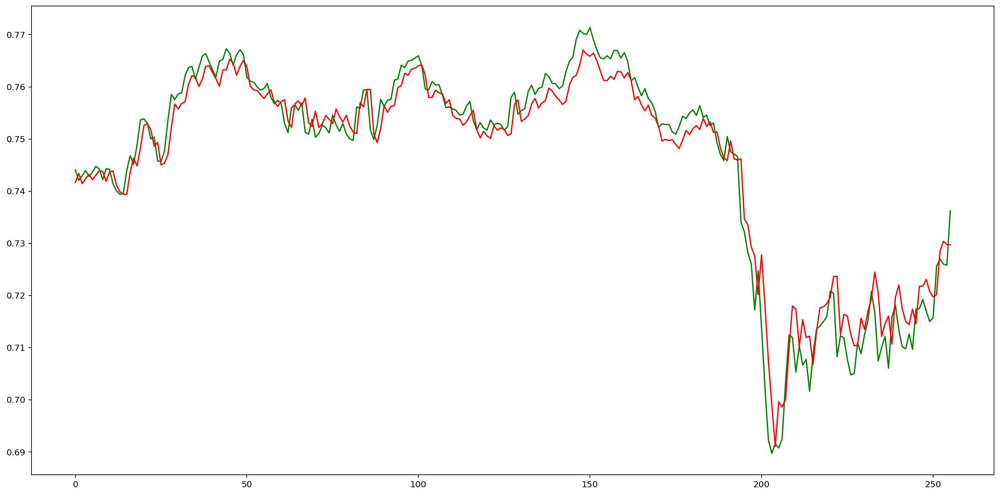

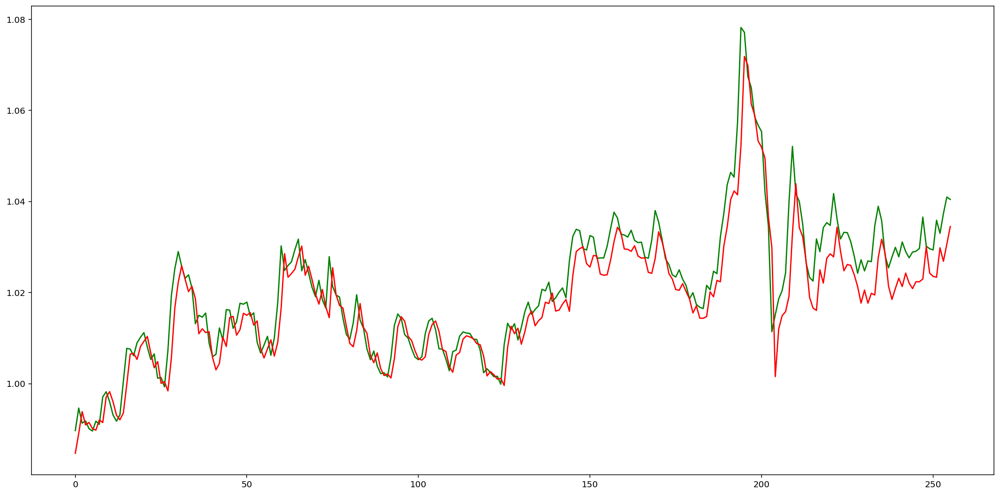

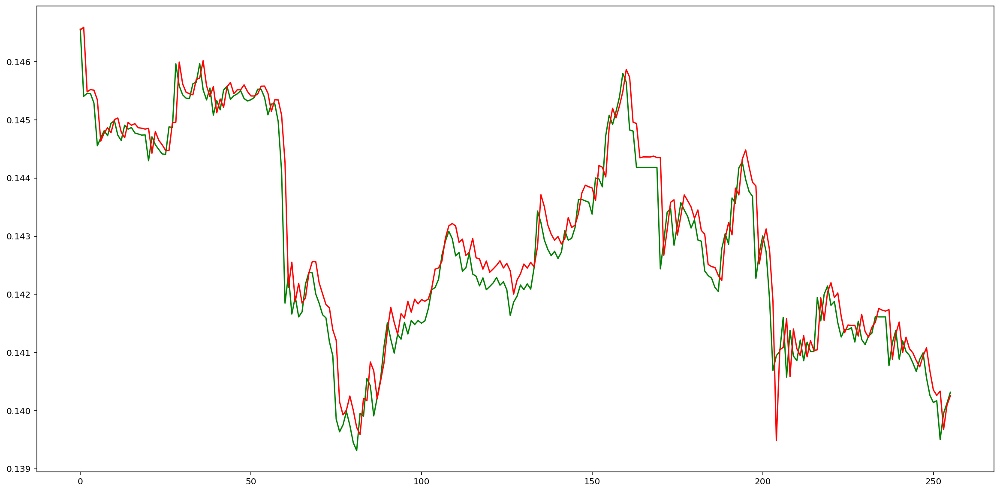

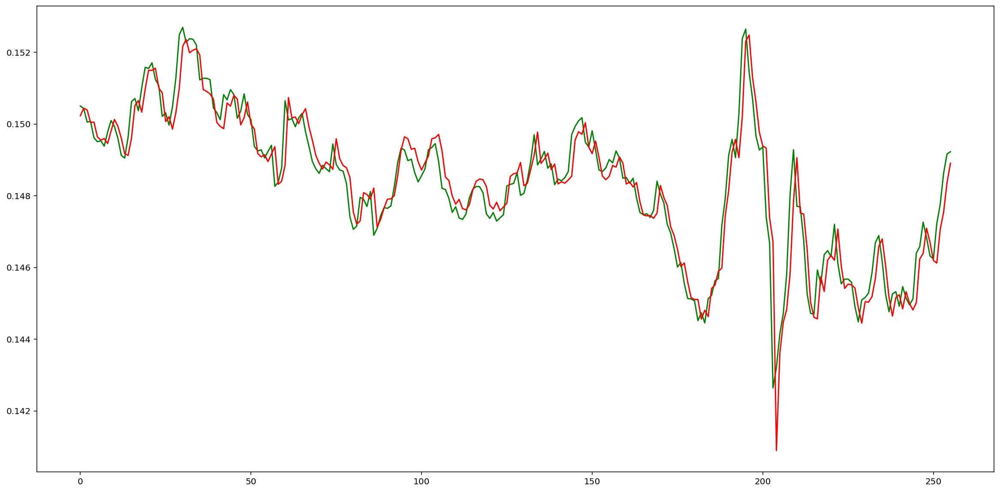

...

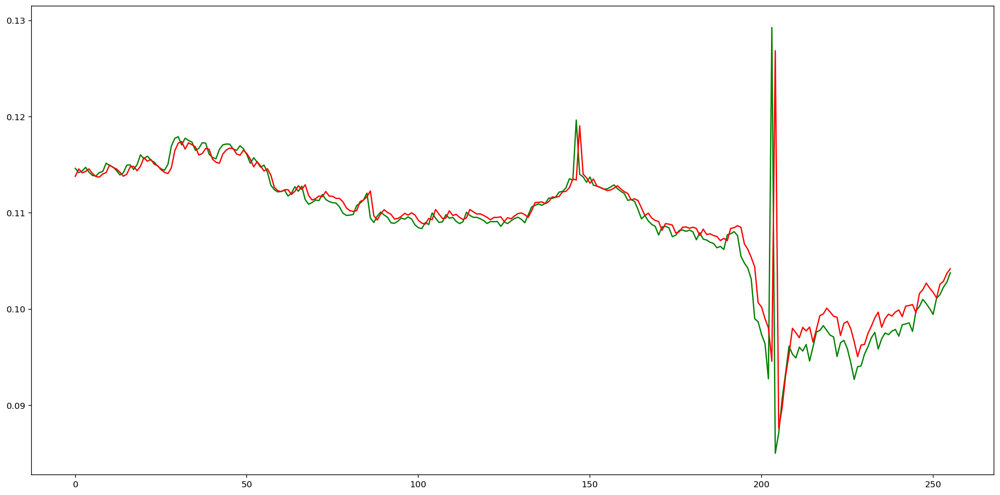

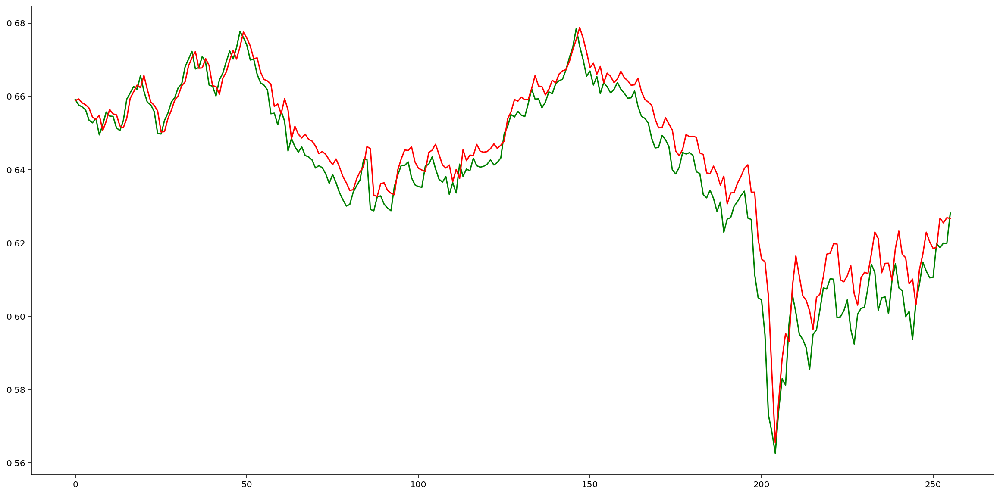

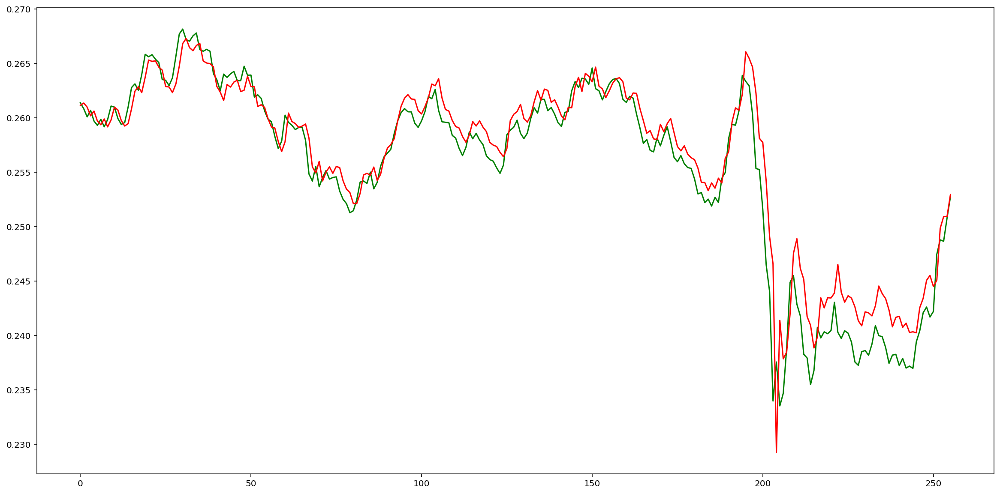

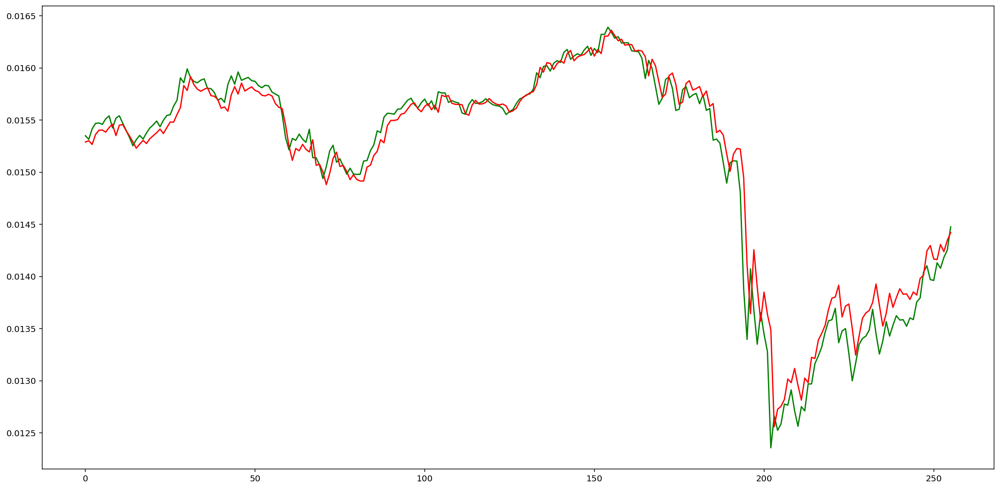

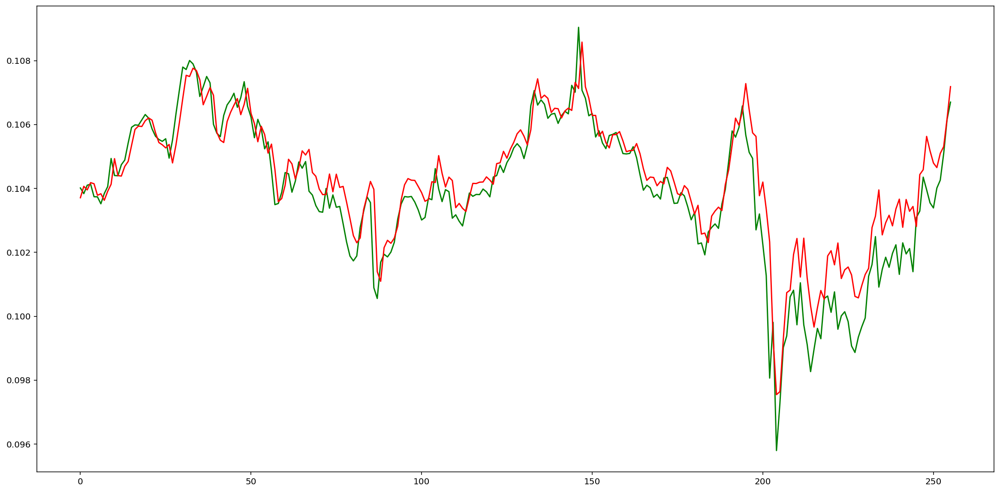

In [ ]:
for i in range(y_hat.shape[1]):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.plot(y_hat[:, i], color='green')
    plt.plot(y_pred[:, i], color='red')

####Оцениваем точность

In [ ]:
MSE(y_hat, y_pred)

2.1993701887944522e-05

In [ ]:
RMSE(y_hat, y_pred)

0.00468974433076522

In [ ]:
MAE(y_hat, y_pred)

0.0022954843817325618

###VARIMAX

####Оцениваем точность

In [ ]:
MSE(y_hat, y_pred)

2.1993701887944522e-05

In [ ]:
RMSE(y_hat, y_pred)

0.00468974433076522

In [ ]:
MAE(y_hat, y_pred)

0.0022954843817325618

##Нейронные сети

###Перцептрон

In [ ]:
 # design network
model = Sequential()
model.add(Dense(128, input_shape=(train_X.shape[1], train_X.shape[2]), activation='relu'))
model.add(Dense(128, activation='relu'))
model.add(Flatten())
model.add(Dense(train_y.shape[1], activation='linear'))
model.compile(loss='mse', optimizer='adam')

Epoch 1/100
5/5 - 0s - loss: 0.2910 - val_loss: 0.0941
Epoch 2/100
5/5 - 0s - loss: 0.1224 - val_loss: 0.0564
Epoch 3/100
5/5 - 0s - loss: 0.0459 - val_loss: 0.0610
Epoch 4/100
5/5 - 0s - loss: 0.0377 - val_loss: 0.0500
Epoch 5/100
5/5 - 0s - loss: 0.0222 - val_loss: 0.0357
Epoch 6/100
5/5 - 0s - loss: 0.0209 - val_loss: 0.0330
Epoch 7/100
5/5 - 0s - loss: 0.0200 - val_loss: 0.0346
Epoch 8/100
5/5 - 0s - loss: 0.0152 - val_loss: 0.0391
Epoch 9/100
5/5 - 0s - loss: 0.0129 - val_loss: 0.0407
Epoch 10/100
5/5 - 0s - loss: 0.0111 - val_loss: 0.0375
Epoch 11/100
5/5 - 0s - loss: 0.0096 - val_loss: 0.0341
Epoch 12/100
5/5 - 0s - loss: 0.0087 - val_loss: 0.0329
Epoch 13/100
5/5 - 0s - loss: 0.0075 - val_loss: 0.0330
Epoch 14/100
5/5 - 0s - loss: 0.0067 - val_loss: 0.0328
Epoch 15/100
5/5 - 0s - loss: 0.0061 - val_loss: 0.0319
Epoch 16/100
5/5 - 0s - loss: 0.0058 - val_loss: 0.0312
Epoch 17/100
5/5 - 0s - loss: 0.0054 - val_loss: 0.0310
Epoch 18/100
5/5 - 0s - loss: 0.0052 - val_loss: 0.0306
E

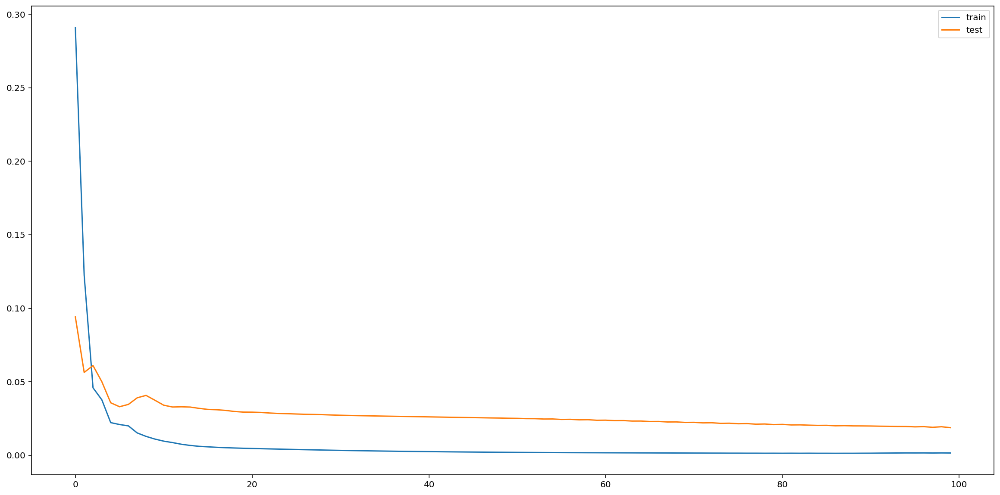

In [ ]:
# fit network

earlyStopping = EarlyStopping(monitor='val_loss', patience=10, verbose=0, mode='min')
mcp_save = ModelCheckpoint('.mdl_wts.hdf5', save_best_only=True, monitor='val_loss', mode='min')
reduce_lr_loss = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=7, verbose=1, epsilon=1e-4, mode='min')

history = model.fit(train_X, train_y, epochs=100, batch_size=128, validation_data=(test_X, test_y), verbose=2, shuffle=False, callbacks=[earlyStopping, mcp_save, reduce_lr_loss])
#history = model.fit(train_X.reshape(train_X.shape[0], train_X.shape[1], train_X.shape[2], 1), train_y, epochs=100, batch_size=128, validation_data=(test_X.reshape(test_X.shape[0], test_X.shape[1], test_X.shape[2], 1), test_y), verbose=2, shuffle=False)
# plot history
fig, ax = plt.subplots(figsize=(20,10))
pyplot.plot(history.history['loss'], label='train')
pyplot.plot(history.history['val_loss'], label='test')
pyplot.legend()
pyplot.show()

In [ ]:
y_hat = scaler.inverse_transform(test_y)
y_pred = scaler.inverse_transform(model.predict(test_X))
#y_pred = scaler.inverse_transform(model.predict(test_X.reshape(test_X.shape[0], test_X.shape[1], test_X.shape[2], 1)))

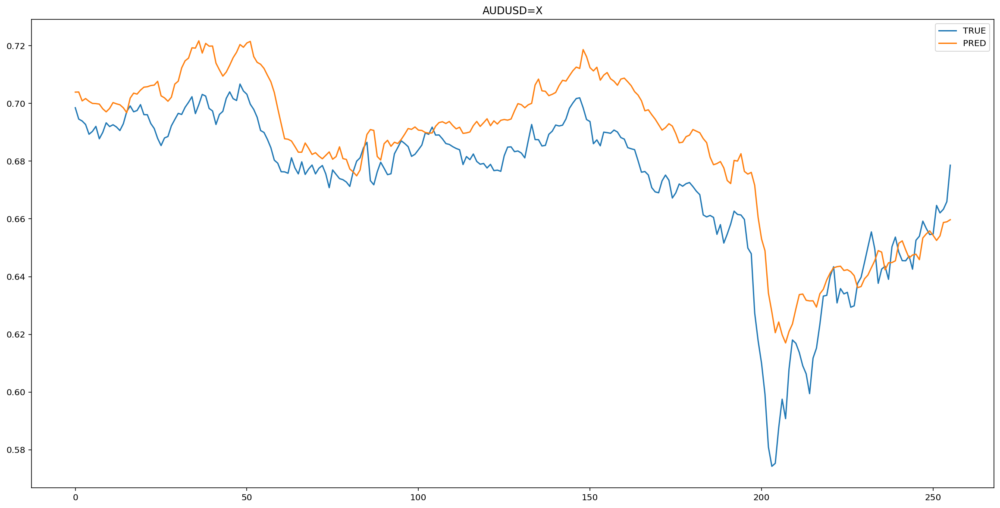

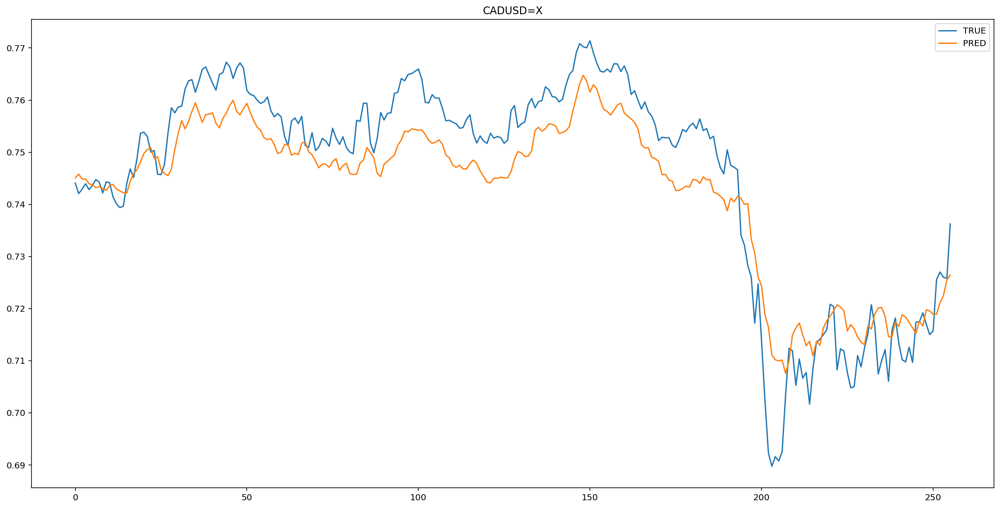

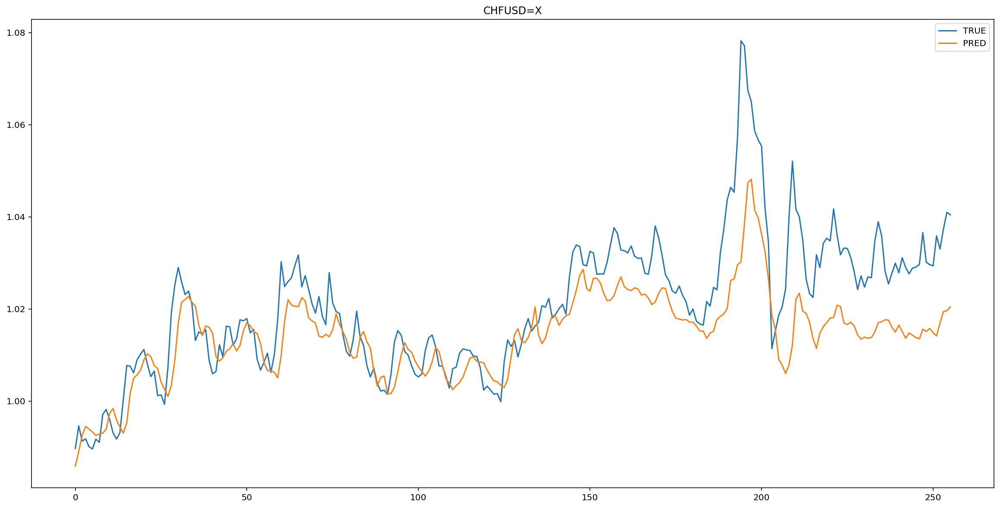

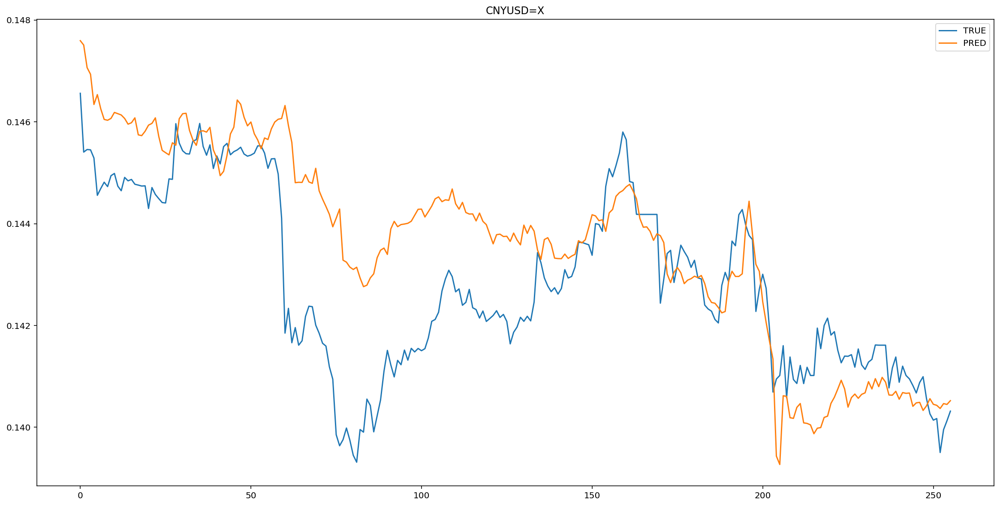

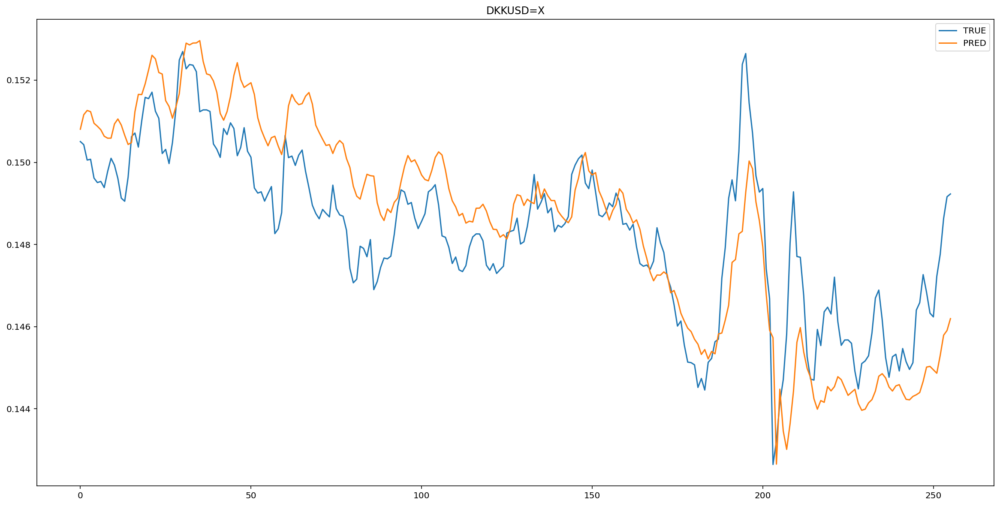

...

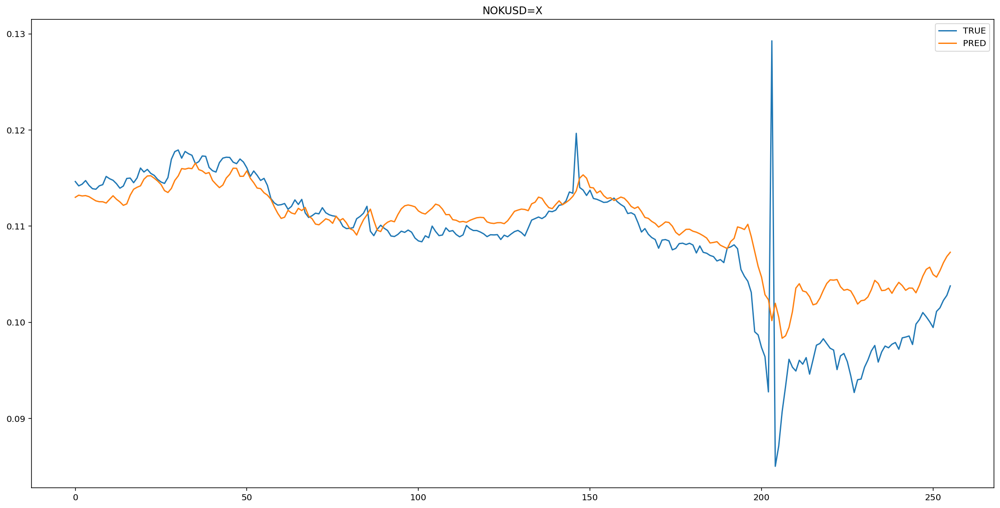

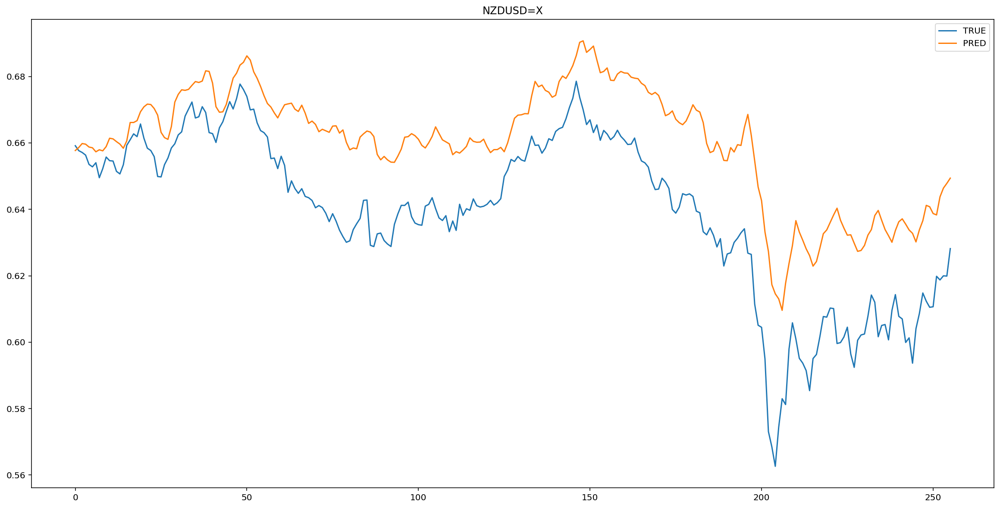

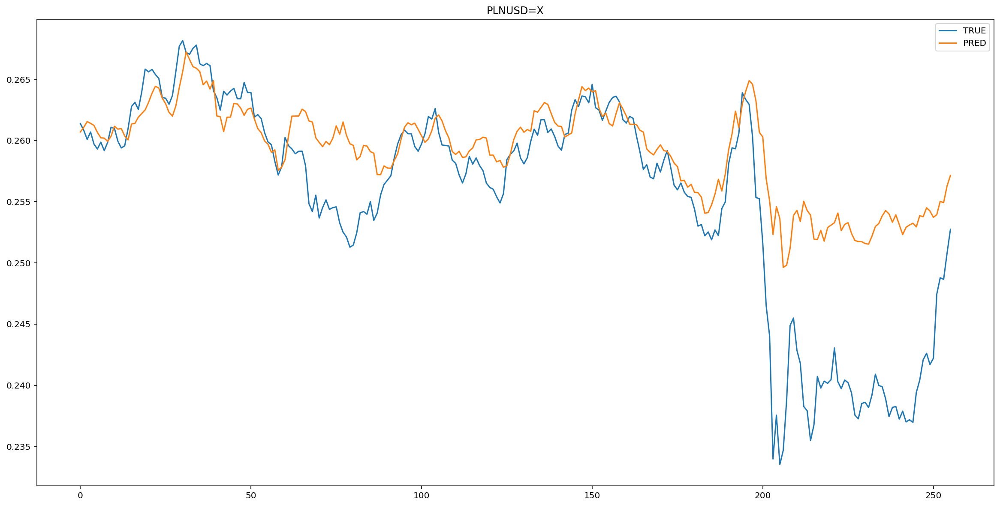

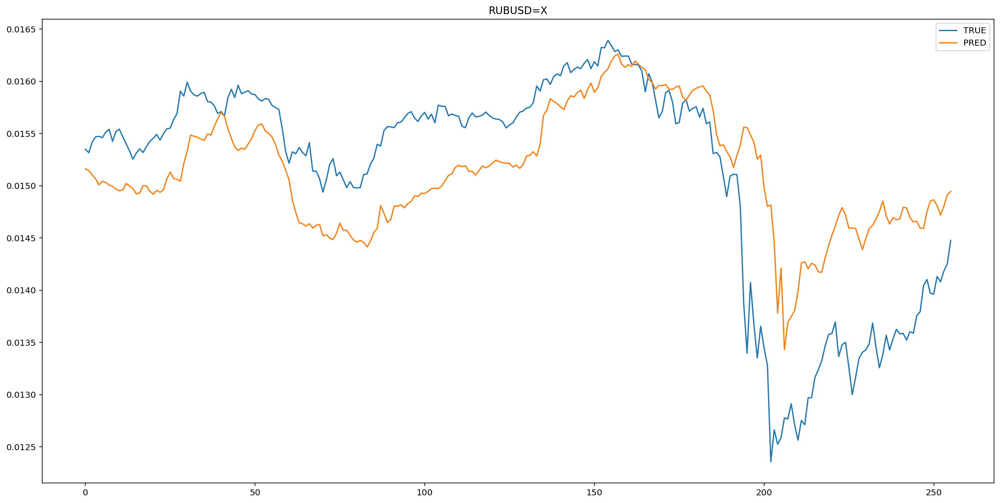

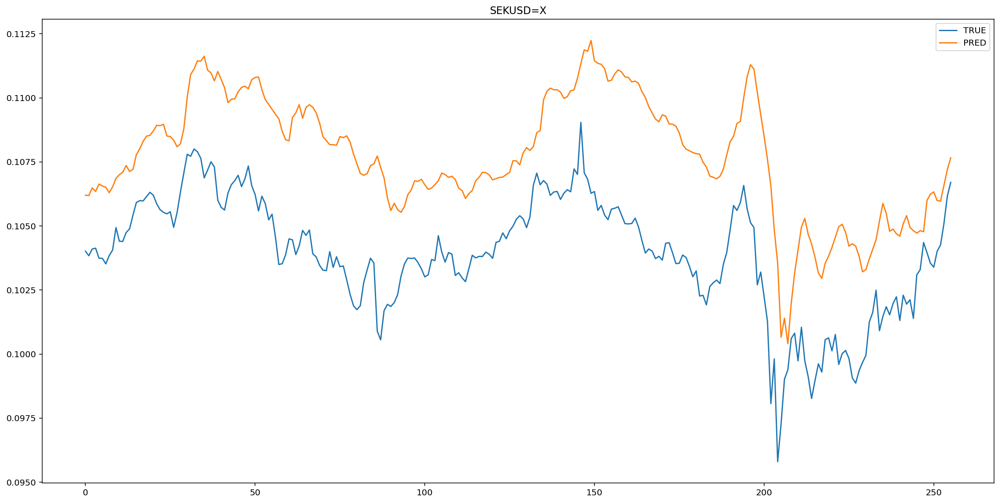

In [ ]:
 for i in range(y_hat.shape[1]):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.title(new_data.columns[i])
    pd.DataFrame(y_hat[:, i],columns=['TRUE']).plot(ax = ax)
    pd.DataFrame(y_pred[:, i],columns=['PRED']).plot(ax = ax)
    plt.show()

####Оцениваем точность

In [ ]:
MSE(y_hat, y_pred)

0.00011182075

In [ ]:
RMSE(y_hat, y_pred)

0.010574533

In [ ]:
MAE(y_hat, y_pred)

0.0060303533

###Свёрточные

In [ ]:
 # design network

model = Sequential()
model.add(Conv2D(128, (2,2) ,input_shape=(train_X.shape[1], train_X.shape[2], 1), activation='relu'))

model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Flatten())
model.add(Dense(64,activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(train_y.shape[1],activation='relu'))

model.compile(loss='mse', optimizer='adam')

In [ ]:
 train_X.reshape(train_X.shape[0], train_X.shape[1], train_X.shape[2], 1).shape

(610, 3, 15, 1)

Epoch 1/100
4/4 - 0s - loss: 0.3582 - val_loss: 0.1534
Epoch 2/100
4/4 - 0s - loss: 0.2799 - val_loss: 0.1213
Epoch 3/100
4/4 - 0s - loss: 0.2538 - val_loss: 0.1021
Epoch 4/100
4/4 - 0s - loss: 0.2327 - val_loss: 0.0906
Epoch 5/100
4/4 - 0s - loss: 0.2109 - val_loss: 0.0783
Epoch 6/100
4/4 - 0s - loss: 0.1986 - val_loss: 0.0694
Epoch 7/100
4/4 - 0s - loss: 0.1918 - val_loss: 0.0609
Epoch 8/100
4/4 - 0s - loss: 0.1899 - val_loss: 0.0549
Epoch 9/100
4/4 - 0s - loss: 0.1801 - val_loss: 0.0519
Epoch 10/100
4/4 - 0s - loss: 0.1684 - val_loss: 0.0489
Epoch 11/100
4/4 - 0s - loss: 0.1636 - val_loss: 0.0404
Epoch 12/100
4/4 - 0s - loss: 0.1498 - val_loss: 0.0356
Epoch 13/100
4/4 - 0s - loss: 0.1396 - val_loss: 0.0335
Epoch 14/100
4/4 - 0s - loss: 0.1343 - val_loss: 0.0301
Epoch 15/100
4/4 - 0s - loss: 0.1254 - val_loss: 0.0256
Epoch 16/100
4/4 - 0s - loss: 0.1180 - val_loss: 0.0213
Epoch 17/100
4/4 - 0s - loss: 0.1087 - val_loss: 0.0186
Epoch 18/100
4/4 - 0s - loss: 0.1069 - val_loss: 0.0162
E

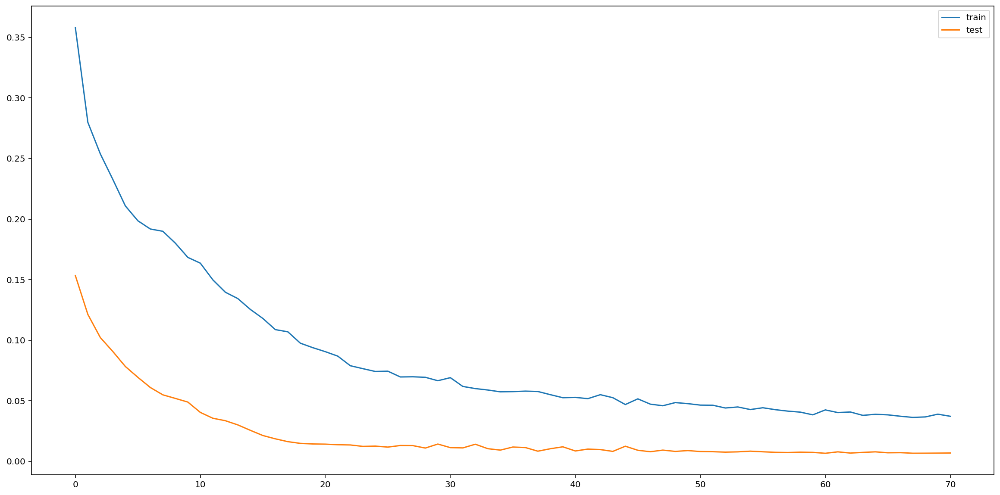

In [ ]:
# fit network
#history = model.fit(train_X, train_y, epochs=100, batch_size=128, validation_data=(test_X, test_y), verbose=2, shuffle=False)
#history = model.fit(train_X.reshape(train_X.shape[0], train_X.shape[1], train_X.shape[2], 1), train_y, epochs=100, batch_size=128, validation_data=(test_X.reshape(test_X.shape[0], test_X.shape[1], test_X.shape[2], 1), test_y), verbose=2, shuffle=False)

earlyStopping = EarlyStopping(monitor='val_loss', patience=10, verbose=0, mode='min')
mcp_save = ModelCheckpoint('.mdl_wts.hdf5', save_best_only=True, monitor='val_loss', mode='min')
reduce_lr_loss = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=7, verbose=1, epsilon=1e-4, mode='min')

history = model.fit(train_X.reshape(train_X.shape[0], train_X.shape[1], train_X.shape[2], 1), train_y,\
                    epochs=100, batch_size=128,validation_split=0.25,\
                    verbose=2, shuffle=False, callbacks=[earlyStopping, mcp_save, reduce_lr_loss])
# plot history
fig, ax = plt.subplots(figsize=(20,10))
pyplot.plot(history.history['loss'], label='train')
pyplot.plot(history.history['val_loss'], label='test')
pyplot.legend()
pyplot.show()

In [ ]:
model.evaluate(train_X.reshape(train_X.shape[0], train_X.shape[1], train_X.shape[2], 1), train_y)

20/20 [==============================] - 0s 1ms/step - loss: 0.0097


0.009708797559142113

In [ ]:
y_hat = scaler.inverse_transform(test_y)
#y_pred = scaler.inverse_transform(model.predict(test_X))
y_pred = scaler.inverse_transform(model.predict(test_X.reshape(test_X.shape[0], test_X.shape[1], test_X.shape[2], 1)))

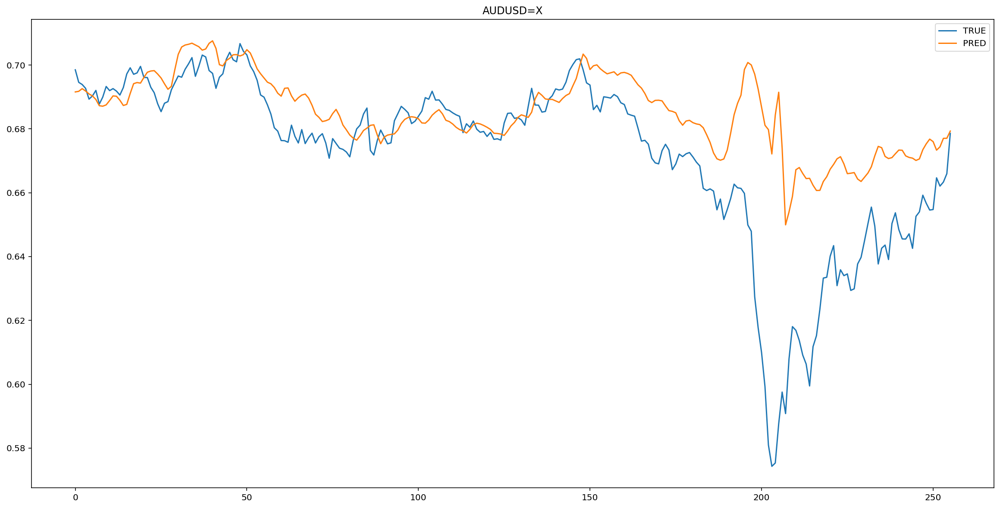

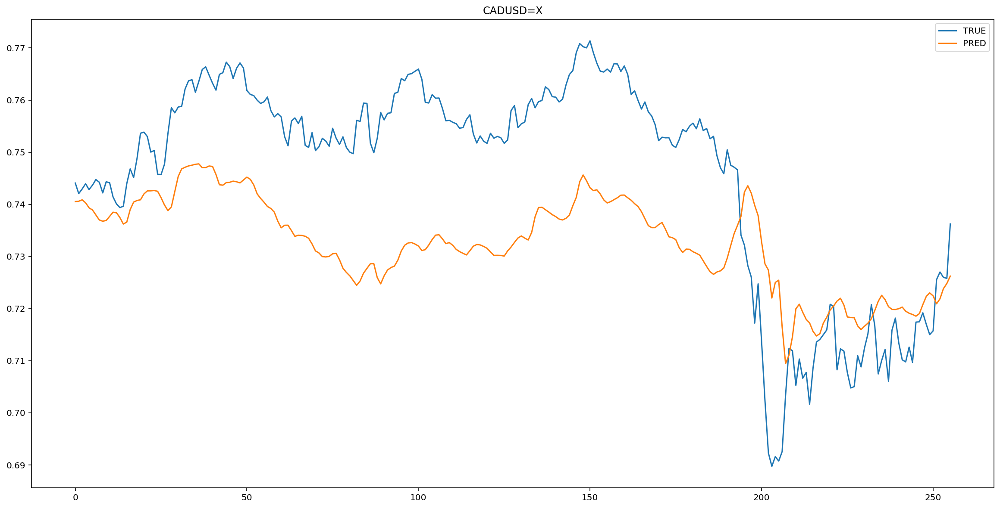

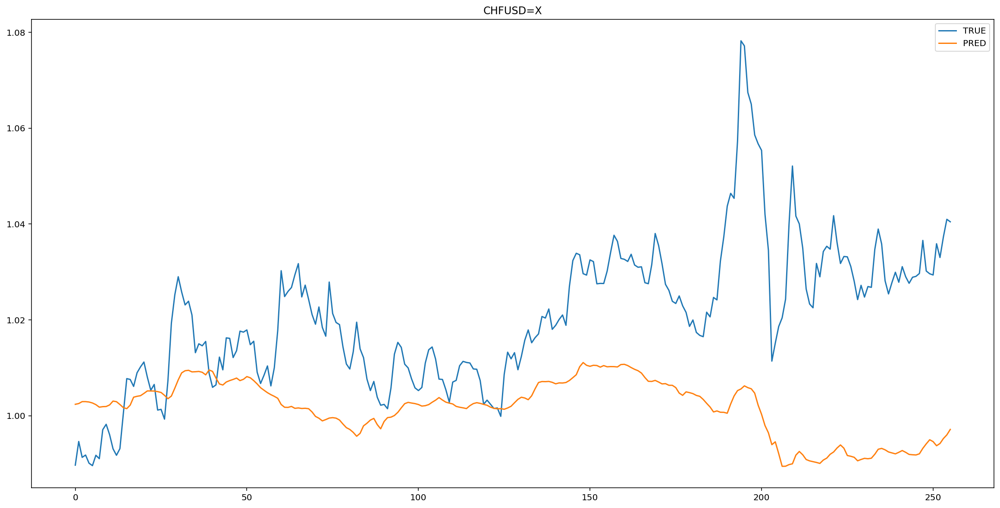

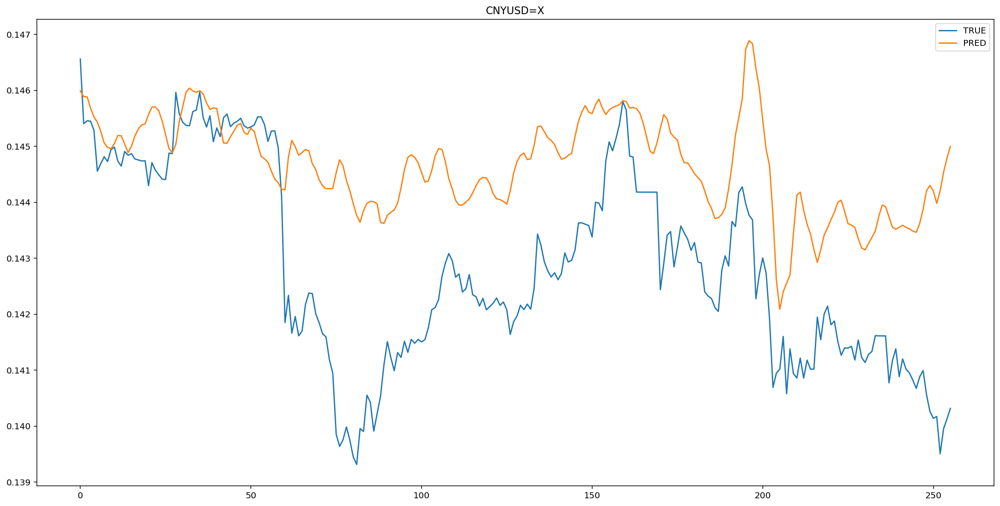

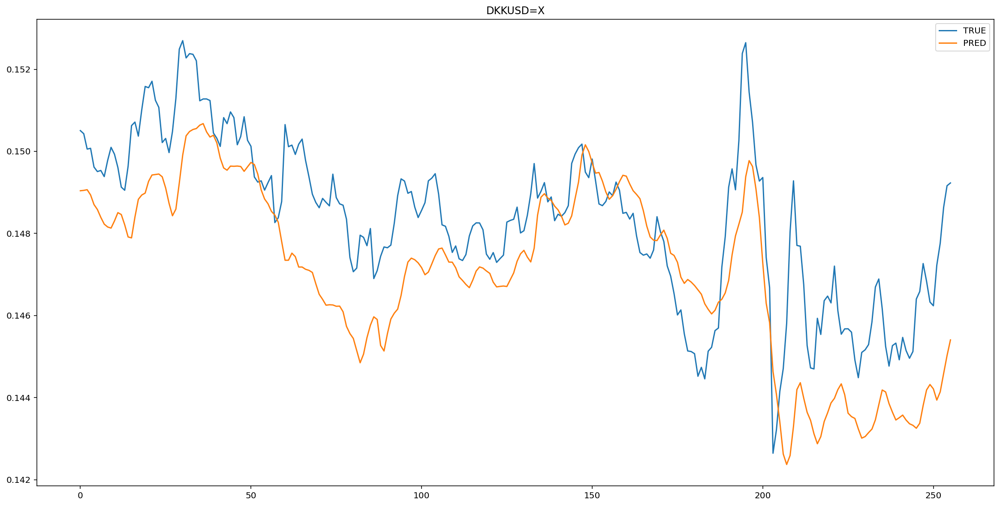

...

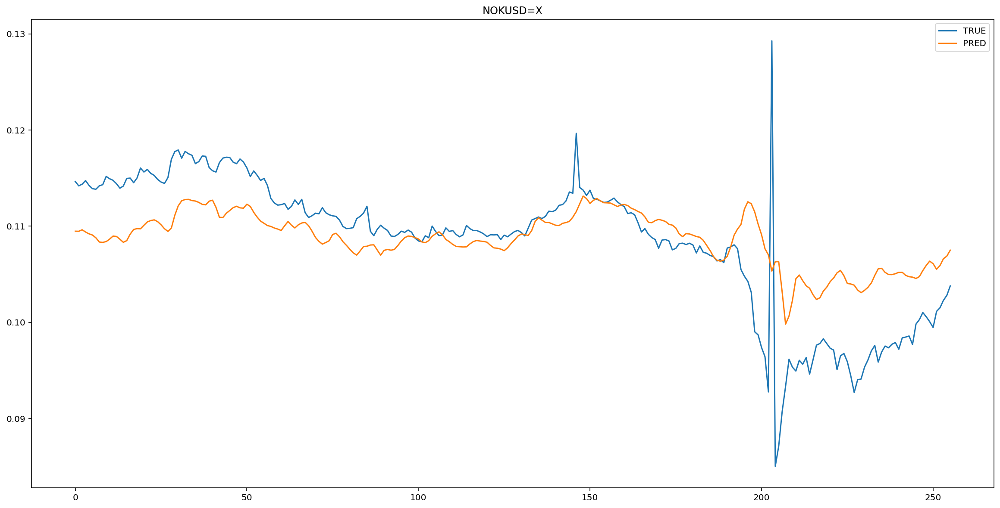

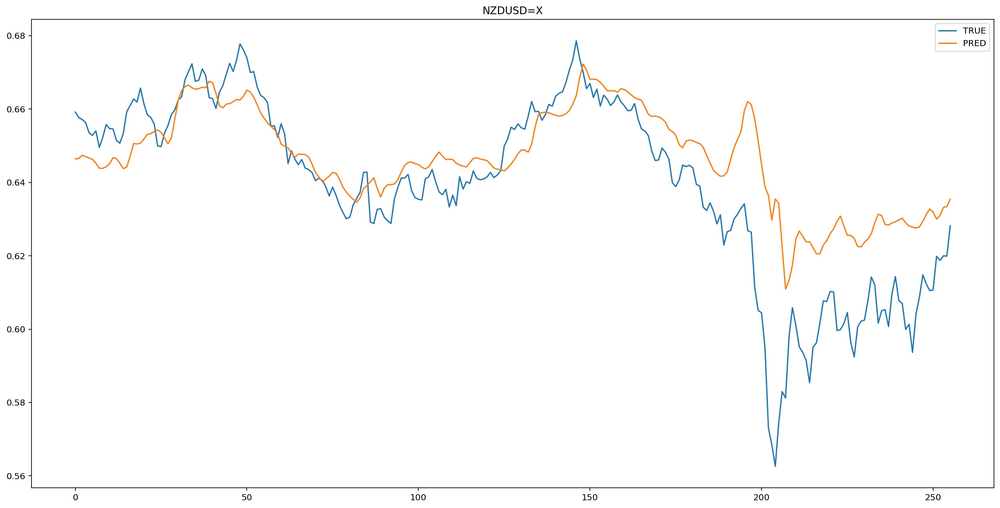

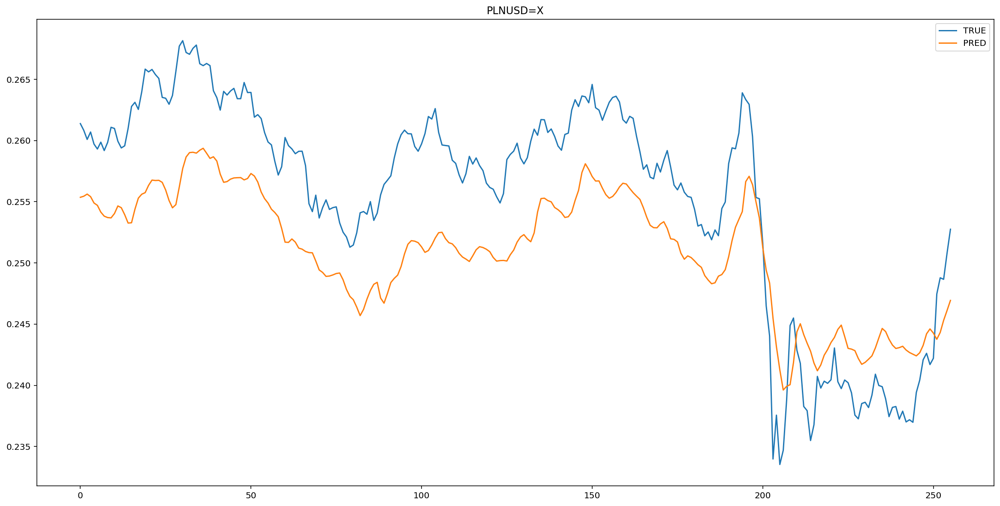

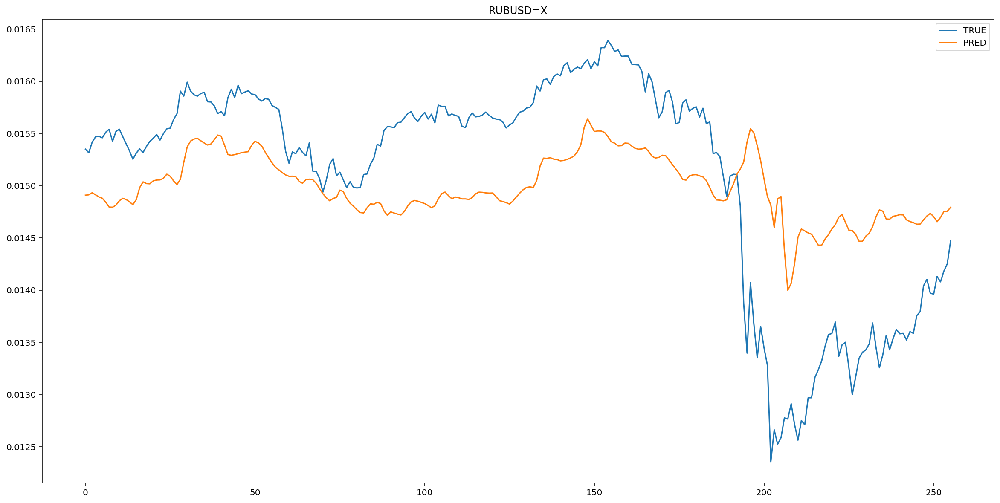

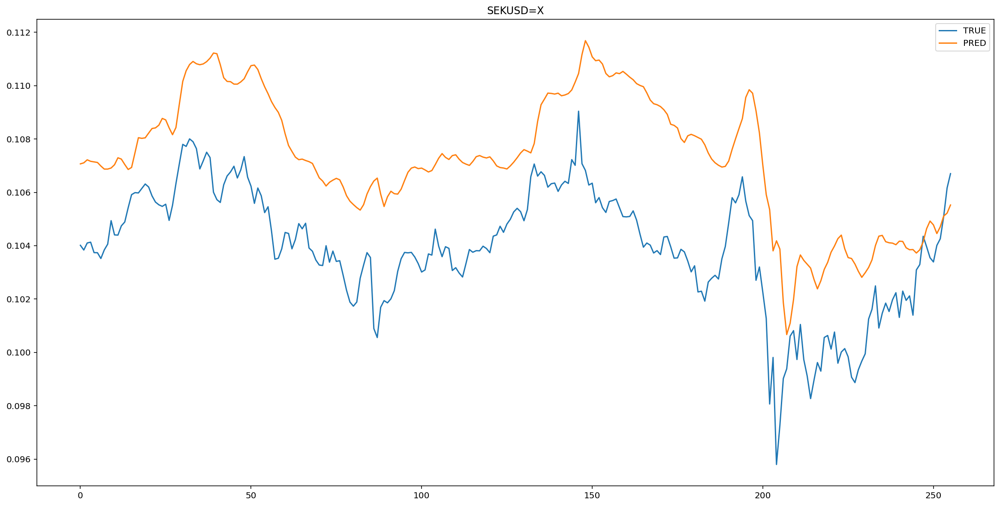

In [ ]:
 for i in range(y_hat.shape[1]):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.title(new_data.columns[i])
    pd.DataFrame(y_hat[:, i],columns=['TRUE']).plot(ax = ax)
    pd.DataFrame(y_pred[:, i],columns=['PRED']).plot(ax = ax)
    plt.show()

####Оцениваем точность

In [ ]:
MSE(y_hat, y_pred)

0.00024116655

In [ ]:
RMSE(y_hat, y_pred)

0.015529538

In [ ]:
MAE(y_hat, y_pred)

0.008437513

###Рекуррентные

####RNN

In [ ]:
# design network
model = Sequential()
model.add(SimpleRNN(128, input_shape=(train_X.shape[1], train_X.shape[2]), return_sequences=True, activation='relu'))
model.add(SimpleRNN(128, return_sequences=False, activation='relu'))
model.add(Dense(train_y.shape[1], activation='linear'))
model.compile(loss='mse', optimizer='adam')

Epoch 1/100
5/5 - 1s - loss: 0.3743 - val_loss: 0.0931
Epoch 2/100
5/5 - 0s - loss: 0.1273 - val_loss: 0.0461
Epoch 3/100
5/5 - 0s - loss: 0.0462 - val_loss: 0.0391
Epoch 4/100
5/5 - 0s - loss: 0.0242 - val_loss: 0.0394
Epoch 5/100
5/5 - 0s - loss: 0.0205 - val_loss: 0.0379
Epoch 6/100
5/5 - 0s - loss: 0.0172 - val_loss: 0.0354
Epoch 7/100
5/5 - 0s - loss: 0.0116 - val_loss: 0.0339
Epoch 8/100
5/5 - 0s - loss: 0.0095 - val_loss: 0.0332
Epoch 9/100
5/5 - 0s - loss: 0.0080 - val_loss: 0.0325
Epoch 10/100
5/5 - 0s - loss: 0.0069 - val_loss: 0.0317
Epoch 11/100
5/5 - 0s - loss: 0.0060 - val_loss: 0.0308
Epoch 12/100
5/5 - 0s - loss: 0.0055 - val_loss: 0.0305
Epoch 13/100
5/5 - 0s - loss: 0.0051 - val_loss: 0.0303
Epoch 14/100
5/5 - 0s - loss: 0.0046 - val_loss: 0.0299
Epoch 15/100
5/5 - 0s - loss: 0.0043 - val_loss: 0.0294
Epoch 16/100
5/5 - 0s - loss: 0.0041 - val_loss: 0.0291
Epoch 17/100
5/5 - 0s - loss: 0.0039 - val_loss: 0.0291
Epoch 18/100
5/5 - 0s - loss: 0.0037 - val_loss: 0.0290
E

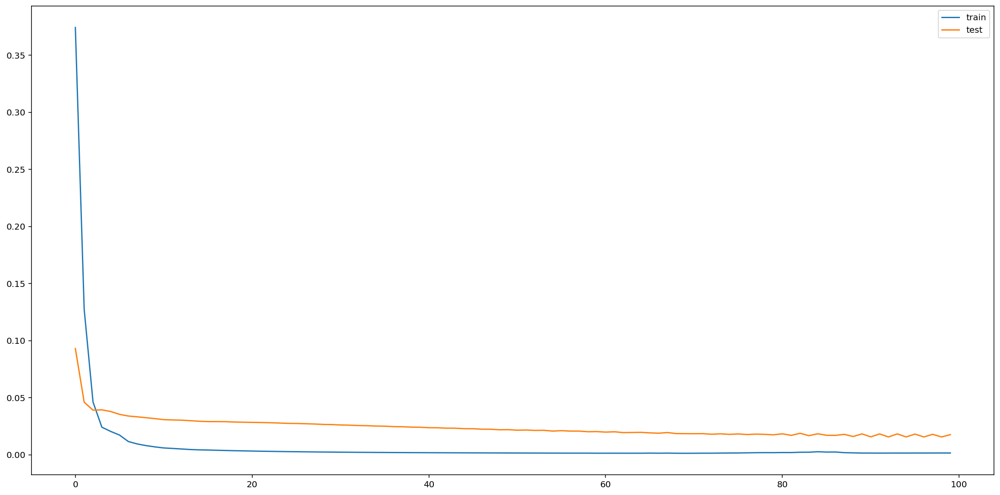

In [ ]:
# fit network

earlyStopping = EarlyStopping(monitor='val_loss', patience=10, verbose=0, mode='min')
mcp_save = ModelCheckpoint('.mdl_wts.hdf5', save_best_only=True, monitor='val_loss', mode='min')
reduce_lr_loss = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=7, verbose=1, epsilon=1e-4, mode='min')

history = model.fit(train_X, train_y, epochs=100, batch_size=128, validation_data=(test_X, test_y), verbose=2, shuffle=False, callbacks=[earlyStopping, mcp_save, reduce_lr_loss])
# plot history
fig, ax = plt.subplots(figsize=(20,10))
pyplot.plot(history.history['loss'], label='train')
pyplot.plot(history.history['val_loss'], label='test')
pyplot.legend()
pyplot.show()

In [ ]:
y_hat = scaler.inverse_transform(test_y)
y_pred = scaler.inverse_transform(model.predict(test_X))
#y_pred = scaler.inverse_transform(model.predict(test_X.reshape(test_X.shape[0], test_X.shape[1], test_X.shape[2], 1)))

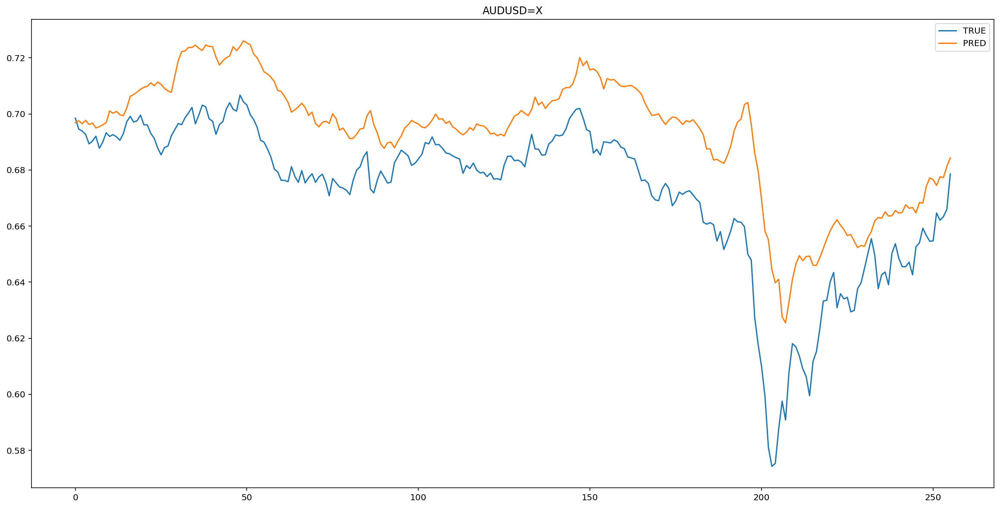

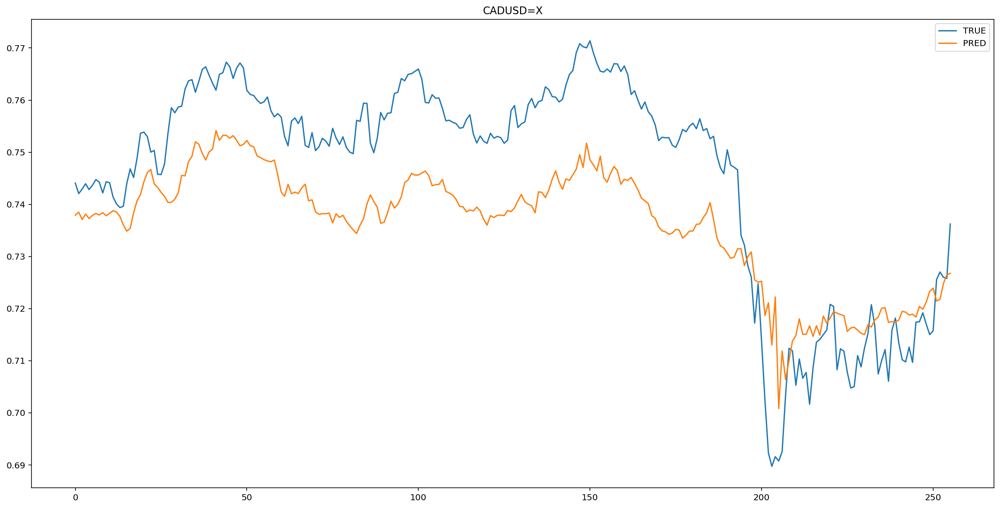

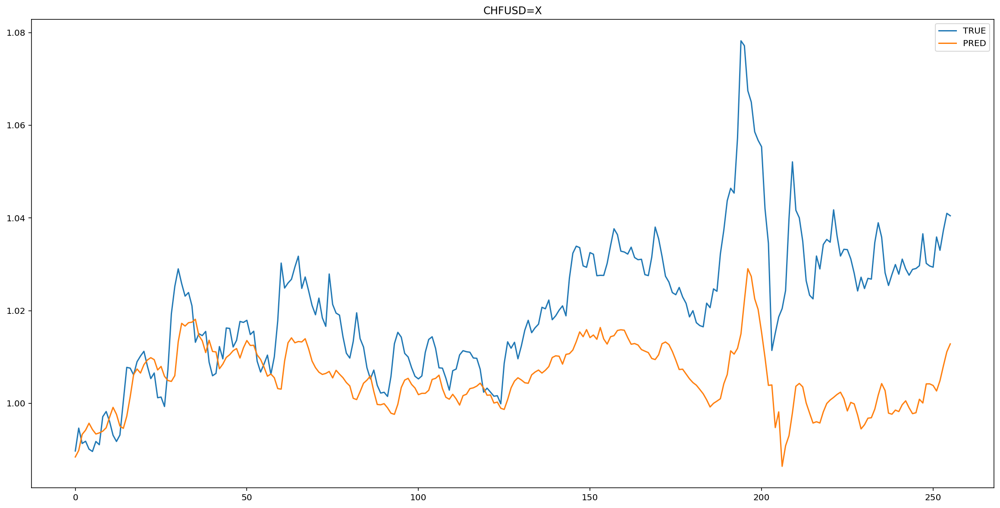

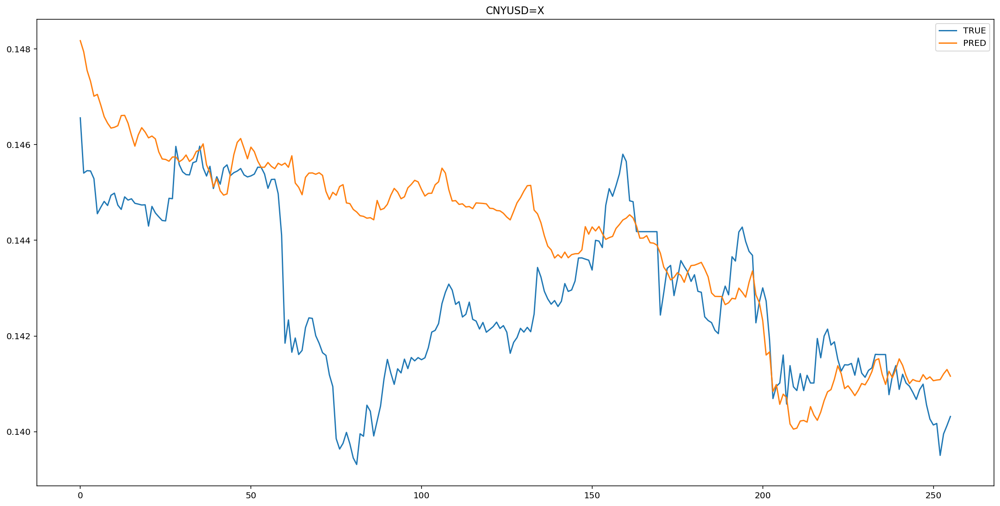

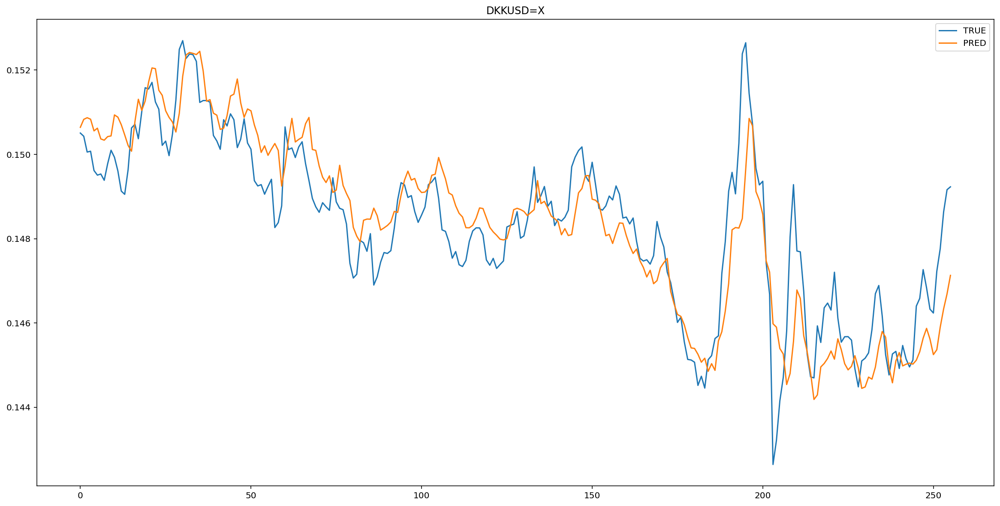

...

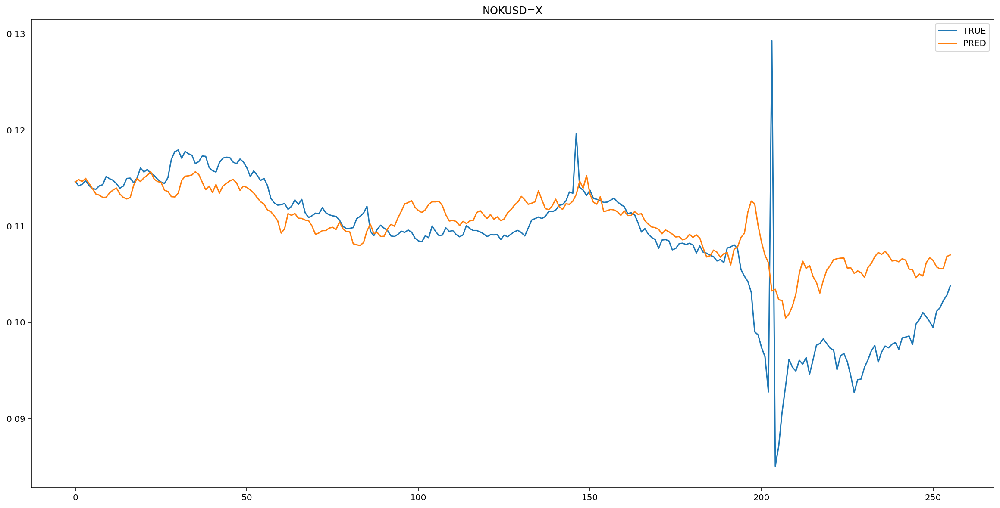

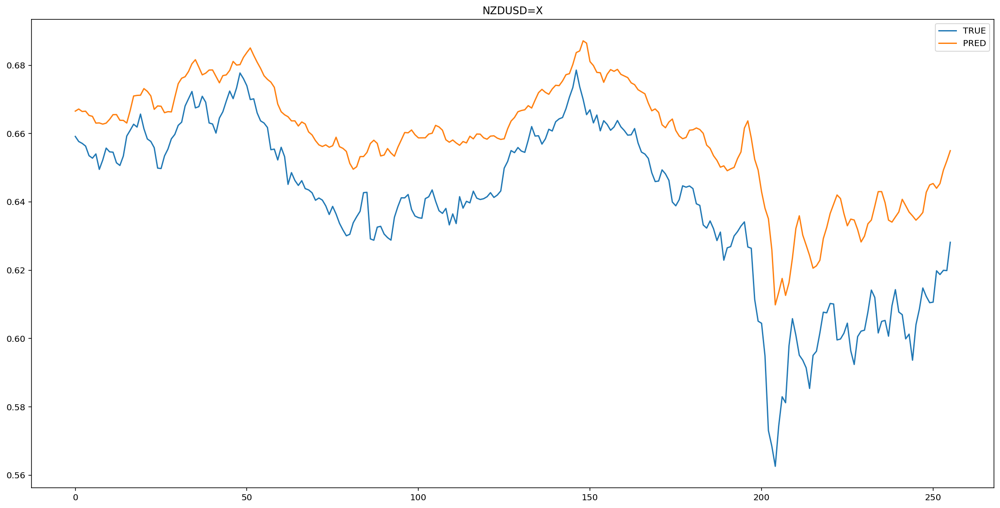

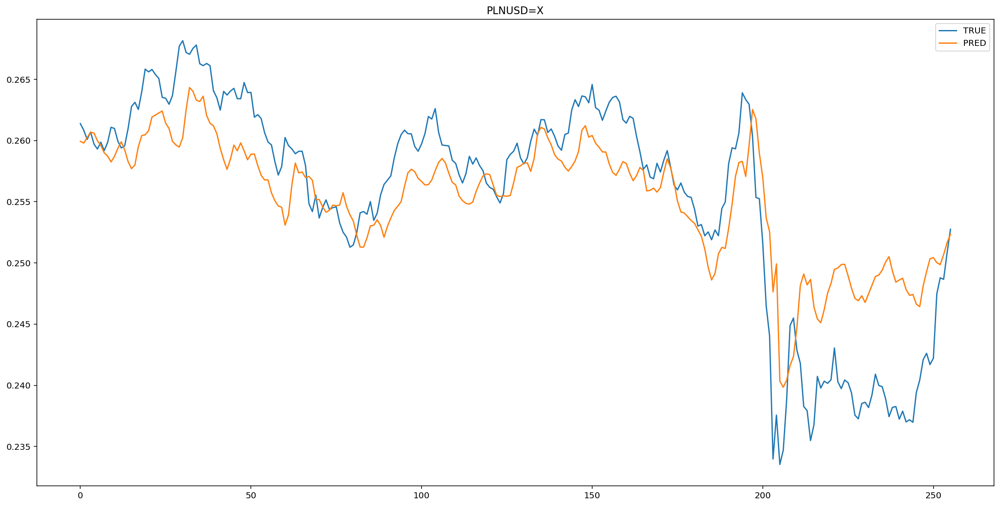

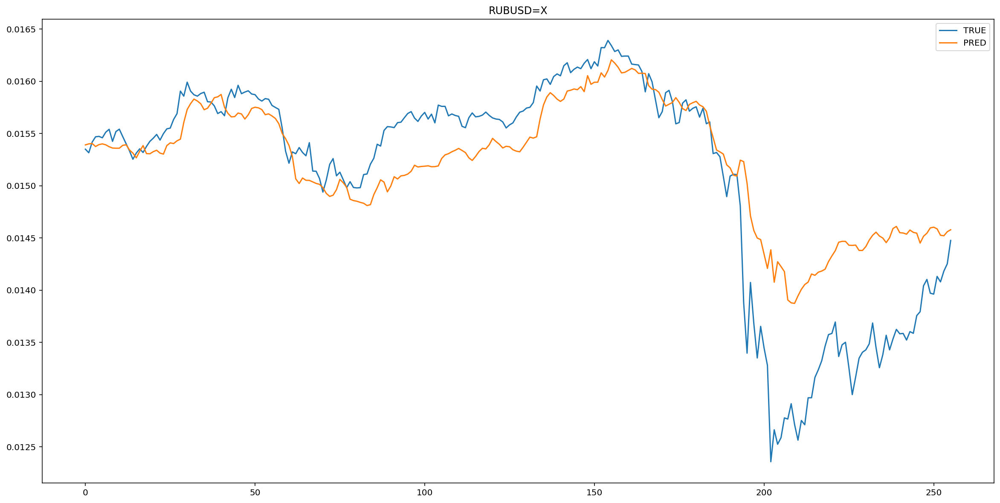

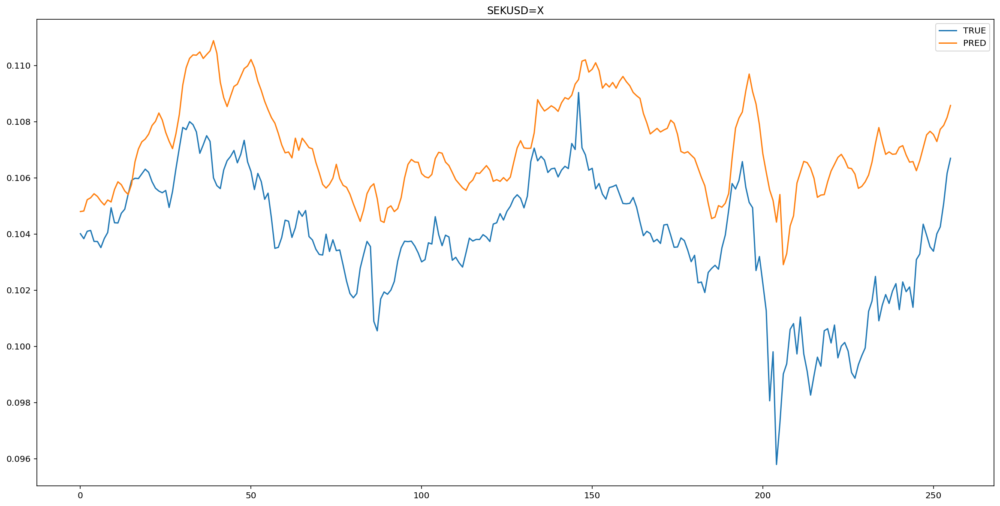

In [ ]:
 for i in range(y_hat.shape[1]):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.title(new_data.columns[i])
    pd.DataFrame(y_hat[:, i],columns=['TRUE']).plot(ax = ax)
    pd.DataFrame(y_pred[:, i],columns=['PRED']).plot(ax = ax)
    plt.show()

Оцениваем точность

####LSTM

In [ ]:
# design network
model = Sequential()
model.add(LSTM(128, input_shape=(train_X.shape[1], train_X.shape[2]), return_sequences=True, activation='relu'))
model.add(LSTM(128, return_sequences=False, activation='relu'))
model.add(Dense(train_y.shape[1], activation='linear'))
model.compile(loss='mse', optimizer='adam')

Epoch 1/100
5/5 - 2s - loss: 0.3617 - val_loss: 0.1560
Epoch 2/100
5/5 - 0s - loss: 0.3138 - val_loss: 0.1289
Epoch 3/100
5/5 - 0s - loss: 0.2463 - val_loss: 0.0902
Epoch 4/100
5/5 - 0s - loss: 0.1436 - val_loss: 0.0502
Epoch 5/100
5/5 - 0s - loss: 0.0726 - val_loss: 0.0424
Epoch 6/100
5/5 - 0s - loss: 0.0506 - val_loss: 0.0361
Epoch 7/100
5/5 - 0s - loss: 0.0243 - val_loss: 0.0385
Epoch 8/100
5/5 - 0s - loss: 0.0248 - val_loss: 0.0386
Epoch 9/100
5/5 - 0s - loss: 0.0243 - val_loss: 0.0377
Epoch 10/100
5/5 - 0s - loss: 0.0233 - val_loss: 0.0349
Epoch 11/100
5/5 - 0s - loss: 0.0203 - val_loss: 0.0334
Epoch 12/100
5/5 - 0s - loss: 0.0190 - val_loss: 0.0330
Epoch 13/100
5/5 - 0s - loss: 0.0183 - val_loss: 0.0334
Epoch 14/100
5/5 - 0s - loss: 0.0177 - val_loss: 0.0337
Epoch 15/100
5/5 - 0s - loss: 0.0167 - val_loss: 0.0340
Epoch 16/100
5/5 - 0s - loss: 0.0158 - val_loss: 0.0341
Epoch 17/100
5/5 - 0s - loss: 0.0149 - val_loss: 0.0338
Epoch 18/100
5/5 - 0s - loss: 0.0139 - val_loss: 0.0333
E

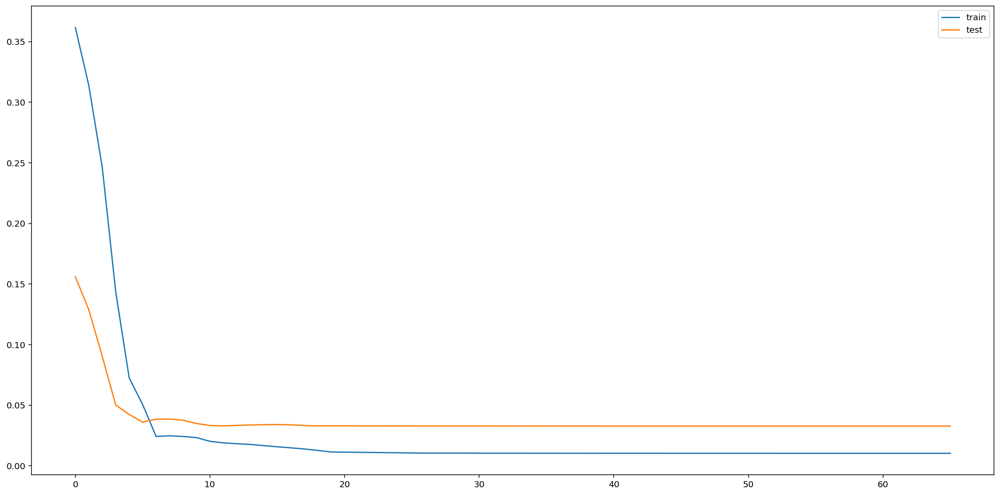

In [ ]:
# fit network

earlyStopping = EarlyStopping(monitor='val_loss', patience=10, verbose=0, mode='min')
mcp_save = ModelCheckpoint('.mdl_wts.hdf5', save_best_only=True, monitor='val_loss', mode='min')
reduce_lr_loss = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=7, verbose=1, epsilon=1e-4, mode='min')

history = model.fit(train_X, train_y, epochs=100, batch_size=128, validation_data=(test_X, test_y), verbose=2, shuffle=False, callbacks=[earlyStopping, mcp_save, reduce_lr_loss])
# plot history
fig, ax = plt.subplots(figsize=(20,10))
pyplot.plot(history.history['loss'], label='train')
pyplot.plot(history.history['val_loss'], label='test')
pyplot.legend()
pyplot.show()

In [ ]:
y_hat = scaler.inverse_transform(test_y)
y_pred = scaler.inverse_transform(model.predict(test_X))
#y_pred = scaler.inverse_transform(model.predict(test_X.reshape(test_X.shape[0], test_X.shape[1], test_X.shape[2], 1)))

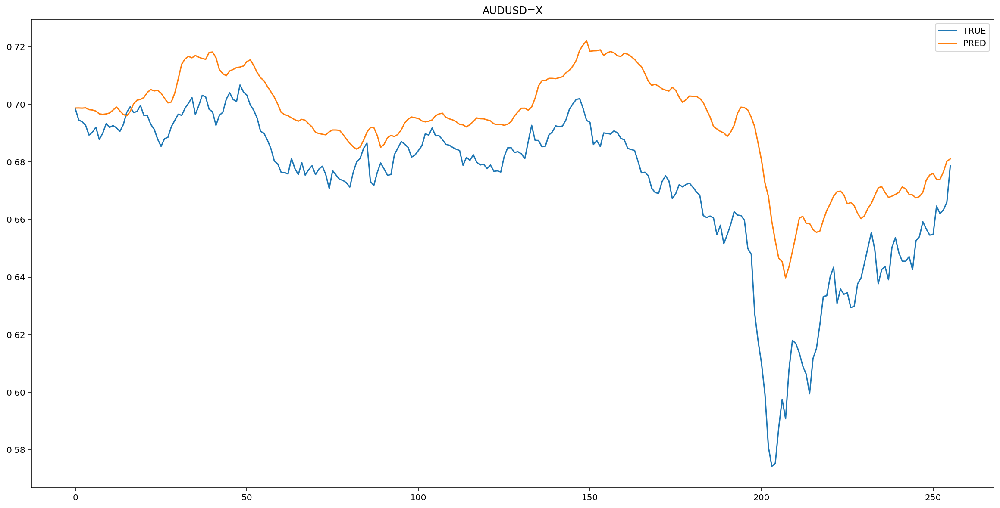

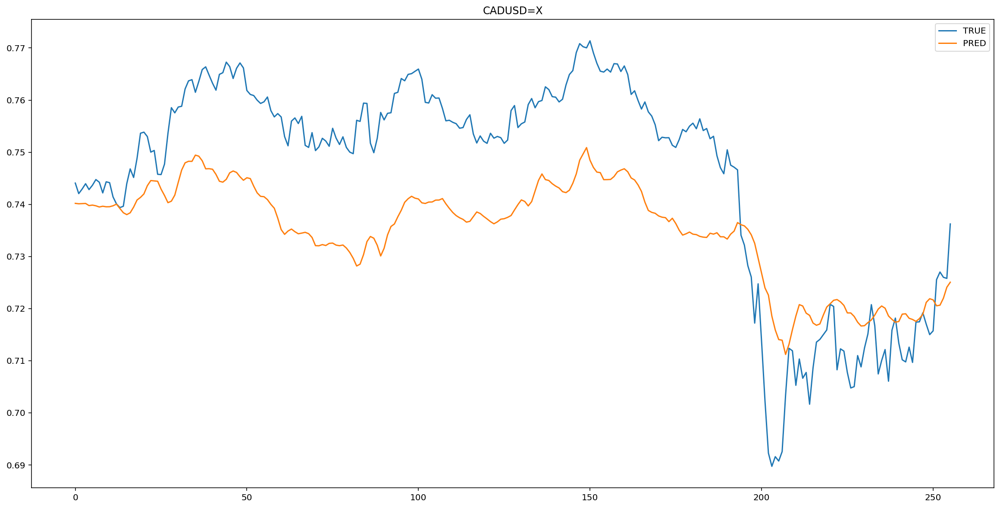

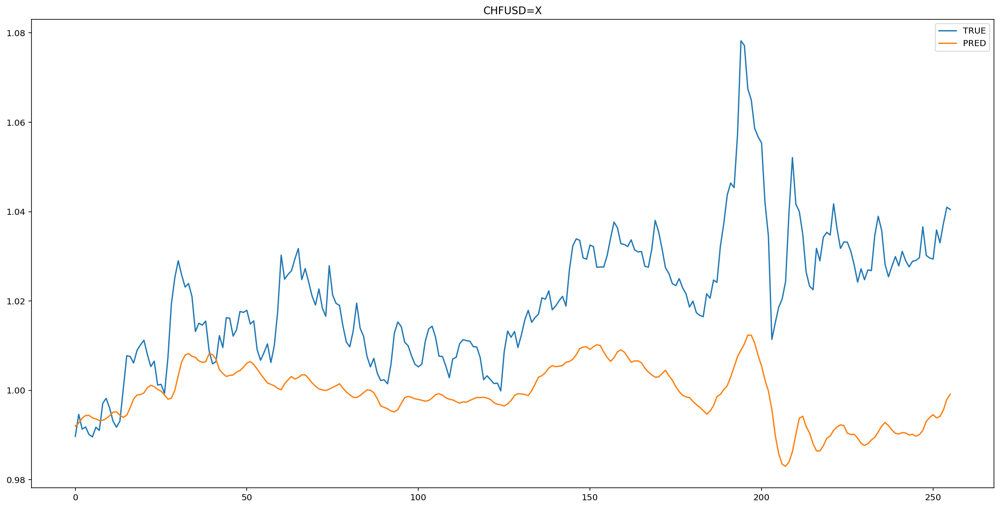

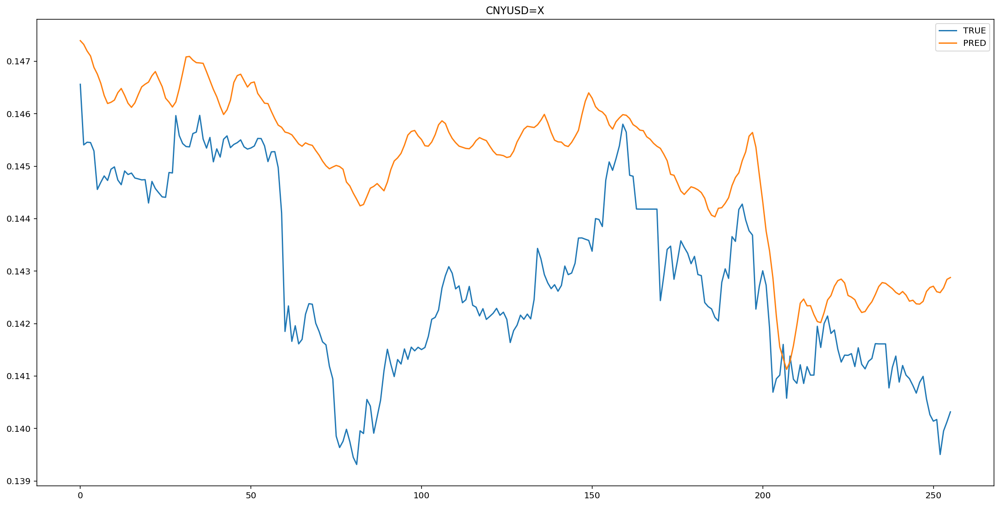

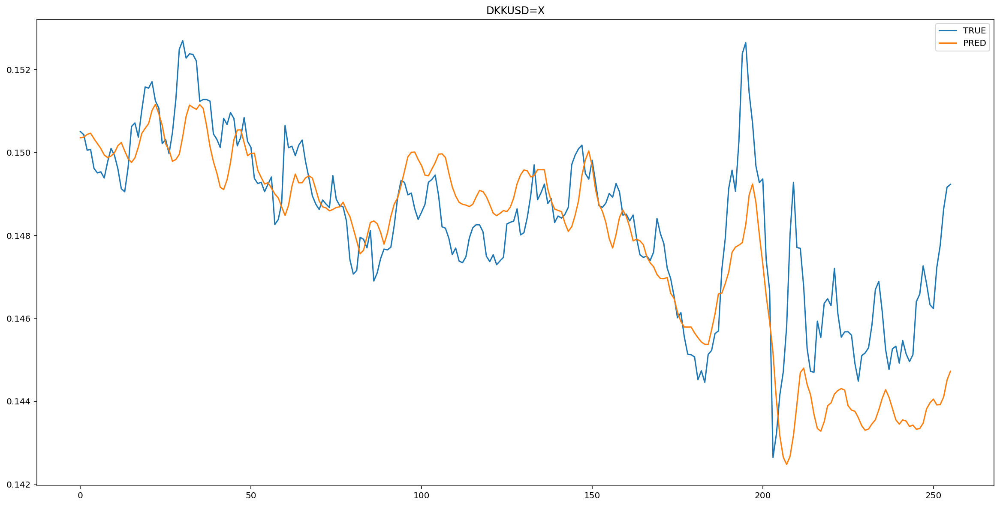

...

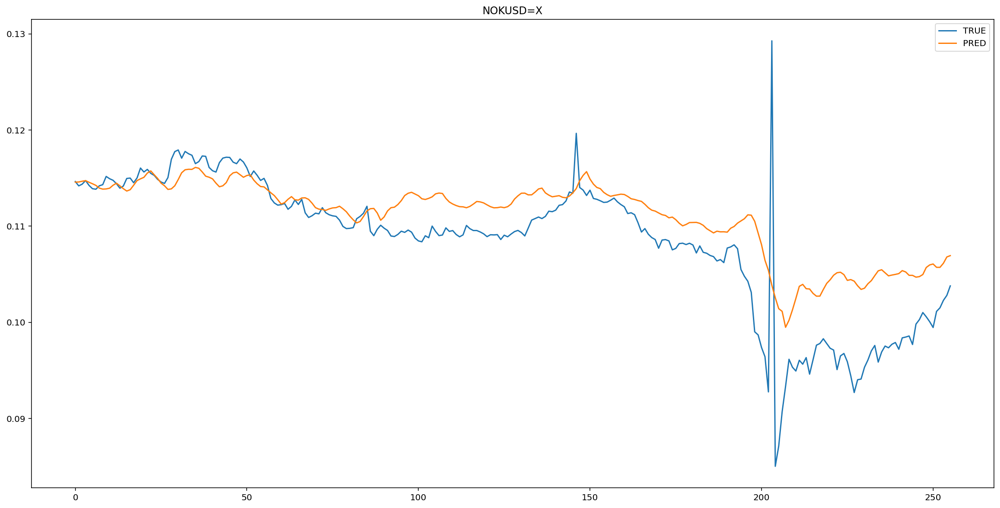

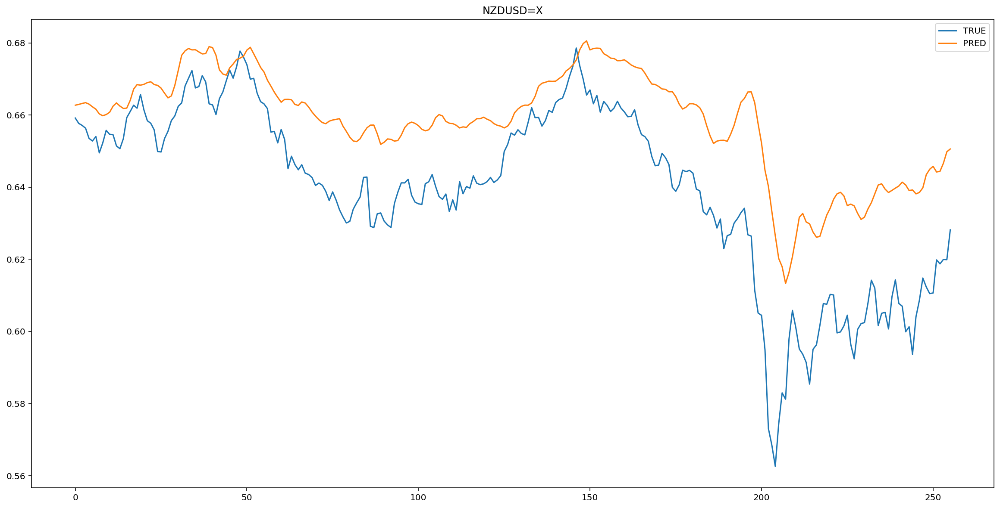

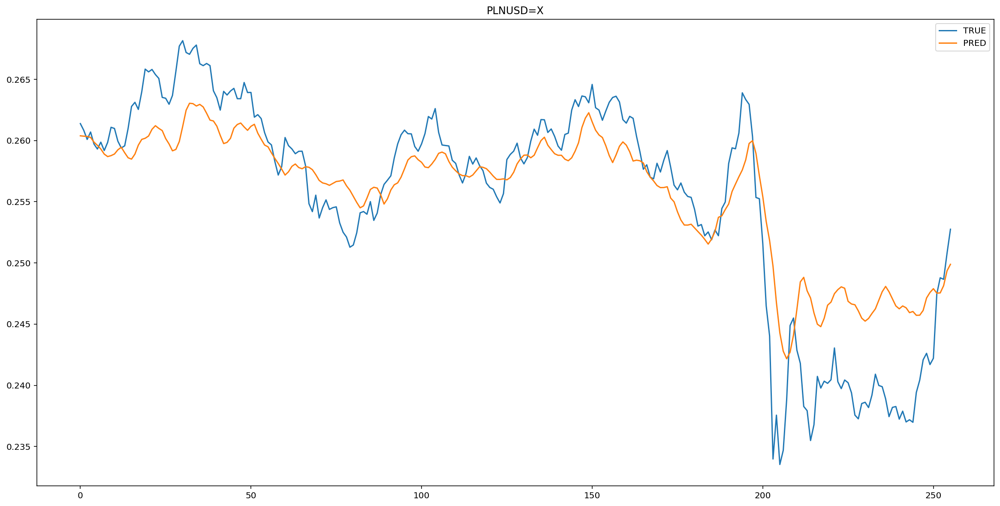

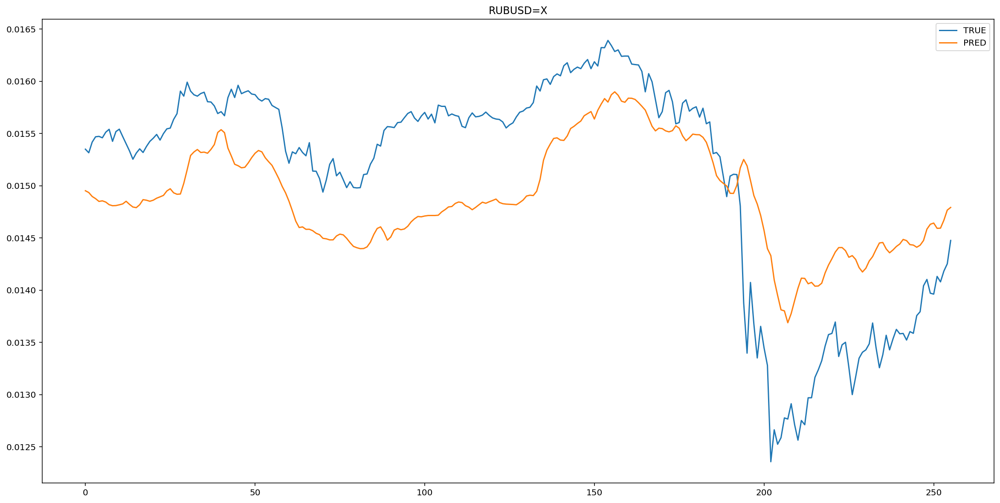

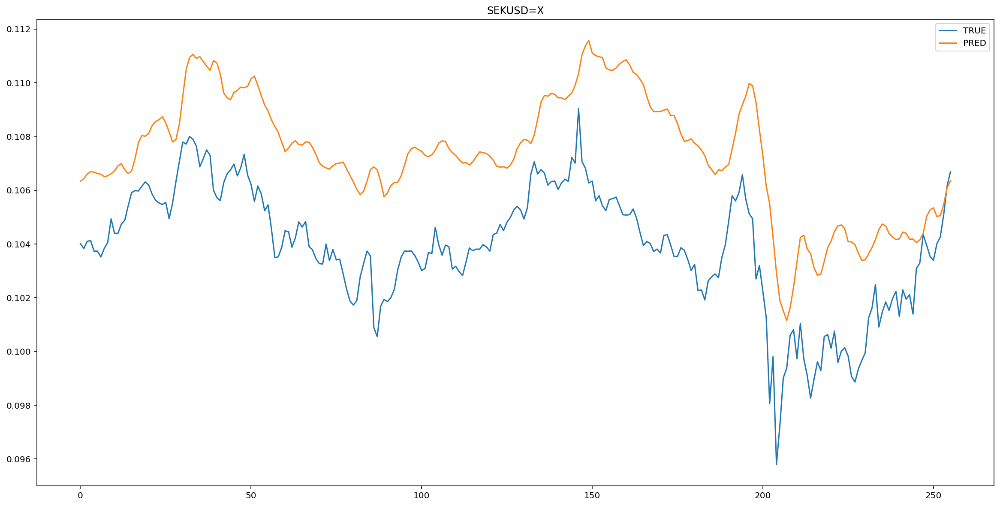

In [ ]:
 for i in range(y_hat.shape[1]):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.title(new_data.columns[i])
    pd.DataFrame(y_hat[:, i],columns=['TRUE']).plot(ax = ax)
    pd.DataFrame(y_pred[:, i],columns=['PRED']).plot(ax = ax)
    plt.show()

Оцениваем точность

####GRU

In [ ]:
# design network
model = Sequential()
model.add(GRU(128, input_shape=(train_X.shape[1], train_X.shape[2]), return_sequences=True, activation='relu'))
model.add(GRU(128, return_sequences=False, activation='relu'))
model.add(Dense(train_y.shape[1], activation='linear'))
model.compile(loss='mse', optimizer='adam')

Epoch 1/100
5/5 - 2s - loss: 0.3482 - val_loss: 0.1331
Epoch 2/100
5/5 - 0s - loss: 0.2420 - val_loss: 0.0862
Epoch 3/100
5/5 - 0s - loss: 0.1240 - val_loss: 0.0512
Epoch 4/100
5/5 - 0s - loss: 0.0499 - val_loss: 0.0589
Epoch 5/100
5/5 - 0s - loss: 0.0391 - val_loss: 0.0412
Epoch 6/100
5/5 - 0s - loss: 0.0199 - val_loss: 0.0350
Epoch 7/100
5/5 - 0s - loss: 0.0243 - val_loss: 0.0340
Epoch 8/100
5/5 - 0s - loss: 0.0210 - val_loss: 0.0350
Epoch 9/100
5/5 - 0s - loss: 0.0183 - val_loss: 0.0372
Epoch 10/100
5/5 - 0s - loss: 0.0172 - val_loss: 0.0354
Epoch 11/100
5/5 - 0s - loss: 0.0155 - val_loss: 0.0336
Epoch 12/100
5/5 - 0s - loss: 0.0148 - val_loss: 0.0334
Epoch 13/100
5/5 - 0s - loss: 0.0137 - val_loss: 0.0342
Epoch 14/100
5/5 - 0s - loss: 0.0129 - val_loss: 0.0342
Epoch 15/100
5/5 - 0s - loss: 0.0119 - val_loss: 0.0334
Epoch 16/100
5/5 - 0s - loss: 0.0110 - val_loss: 0.0326
Epoch 17/100
5/5 - 0s - loss: 0.0100 - val_loss: 0.0322
Epoch 18/100
5/5 - 0s - loss: 0.0092 - val_loss: 0.0319
E

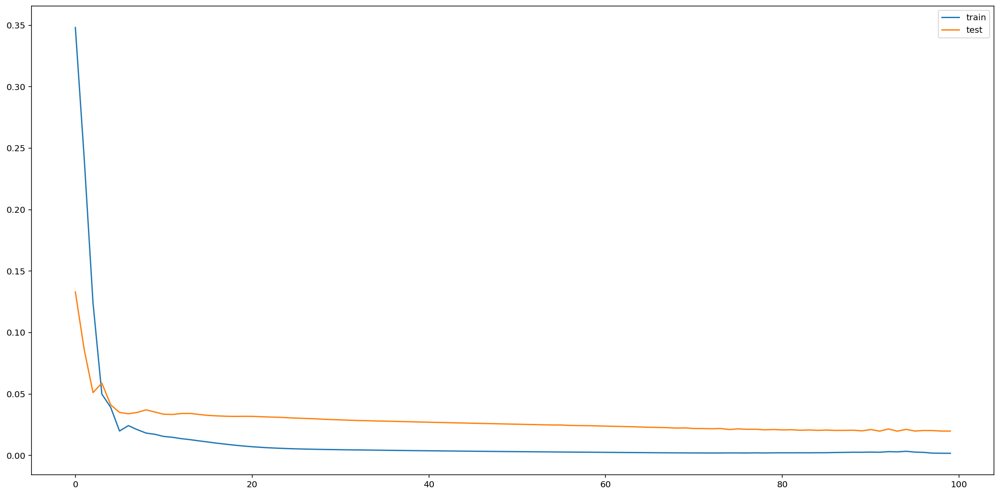

In [ ]:
# fit network

earlyStopping = EarlyStopping(monitor='val_loss', patience=10, verbose=0, mode='min')
mcp_save = ModelCheckpoint('.mdl_wts.hdf5', save_best_only=True, monitor='val_loss', mode='min')
reduce_lr_loss = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=7, verbose=1, epsilon=1e-4, mode='min')

history = model.fit(train_X, train_y, epochs=100, batch_size=128, validation_data=(test_X, test_y), verbose=2, shuffle=False, callbacks=[earlyStopping, mcp_save, reduce_lr_loss])
# plot history
fig, ax = plt.subplots(figsize=(20,10))
pyplot.plot(history.history['loss'], label='train')
pyplot.plot(history.history['val_loss'], label='test')
pyplot.legend()
pyplot.show()

In [ ]:
y_hat = scaler.inverse_transform(test_y)
y_pred = scaler.inverse_transform(model.predict(test_X))
#y_pred = scaler.inverse_transform(model.predict(test_X.reshape(test_X.shape[0], test_X.shape[1], test_X.shape[2], 1)))

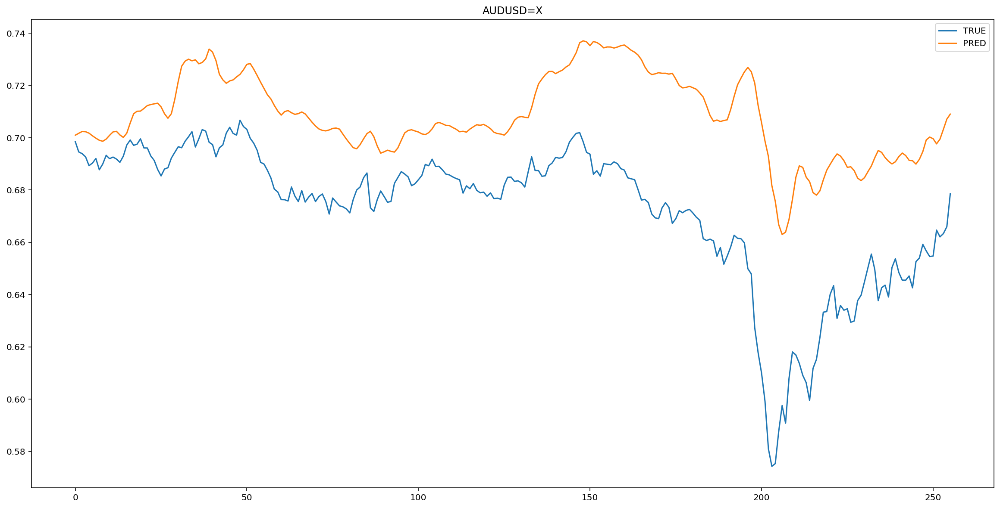

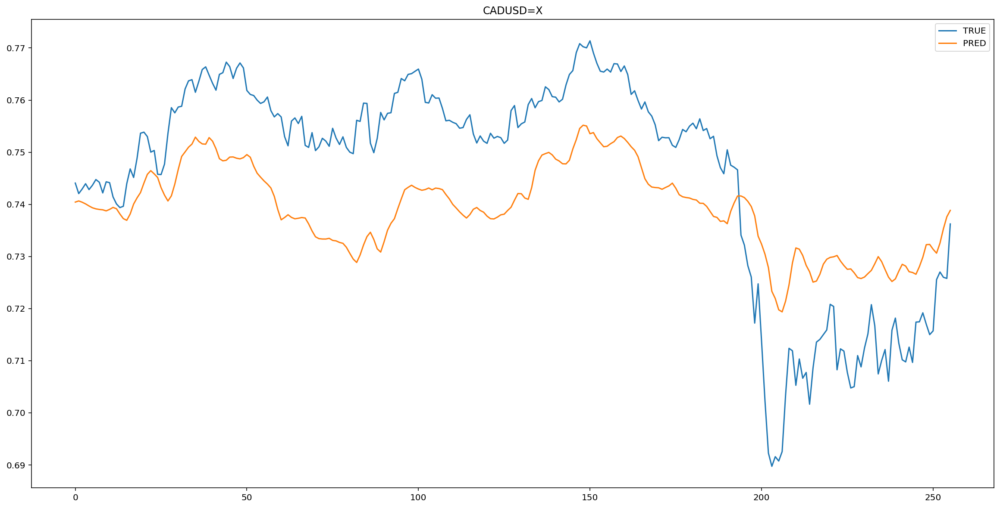

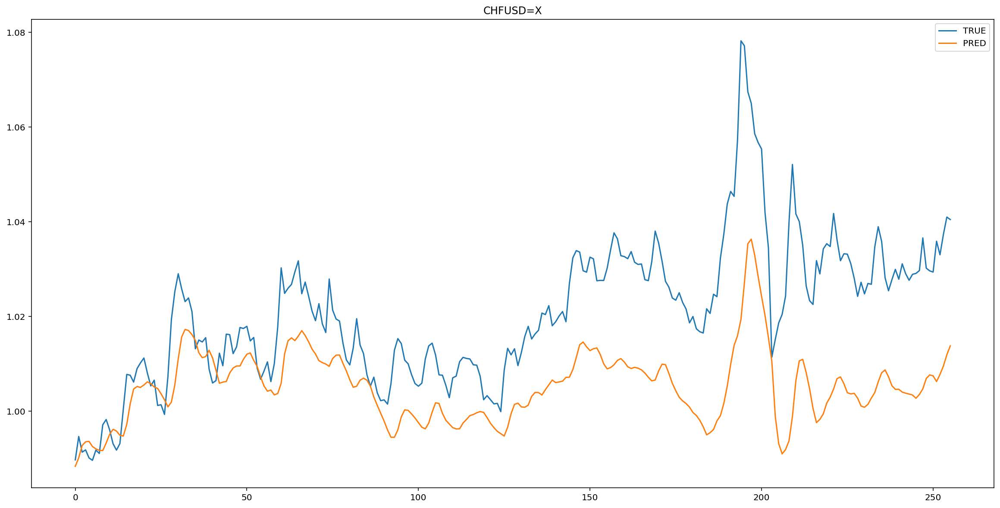

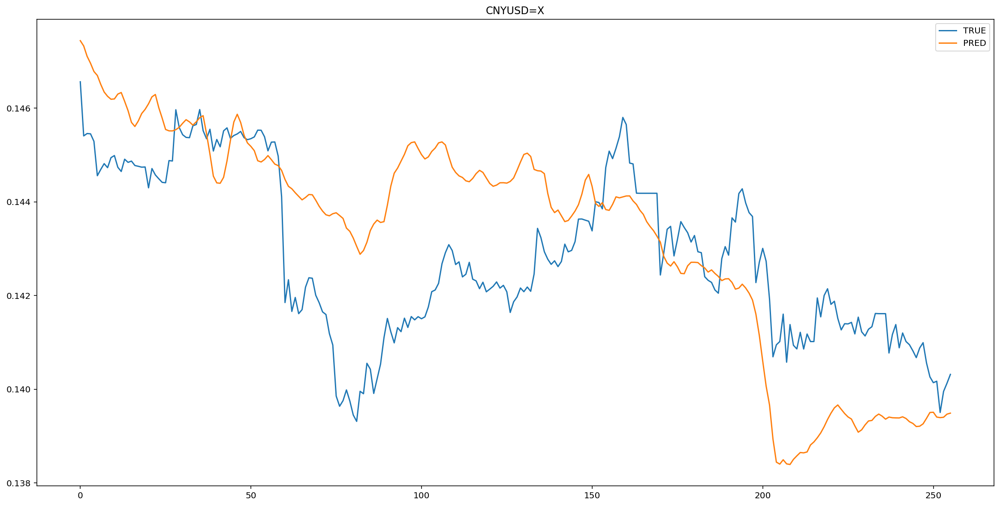

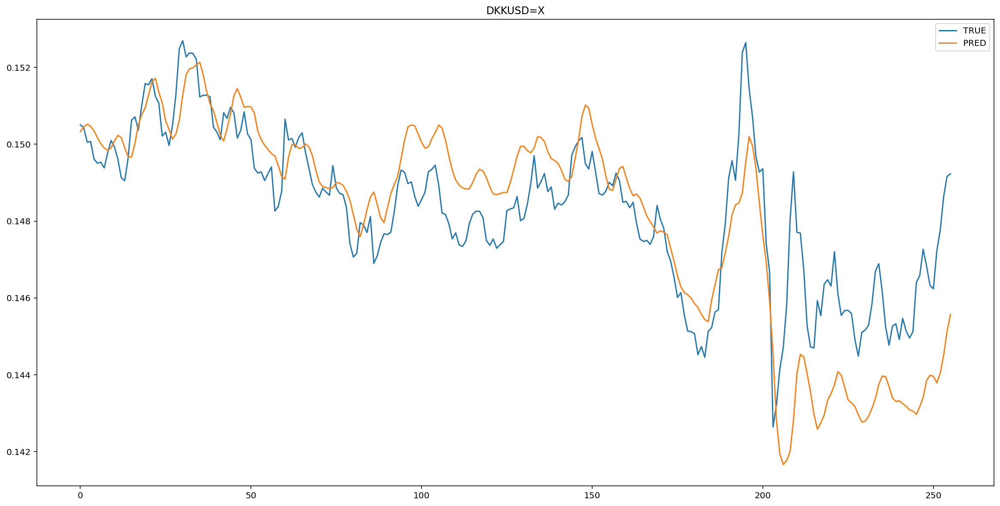

...

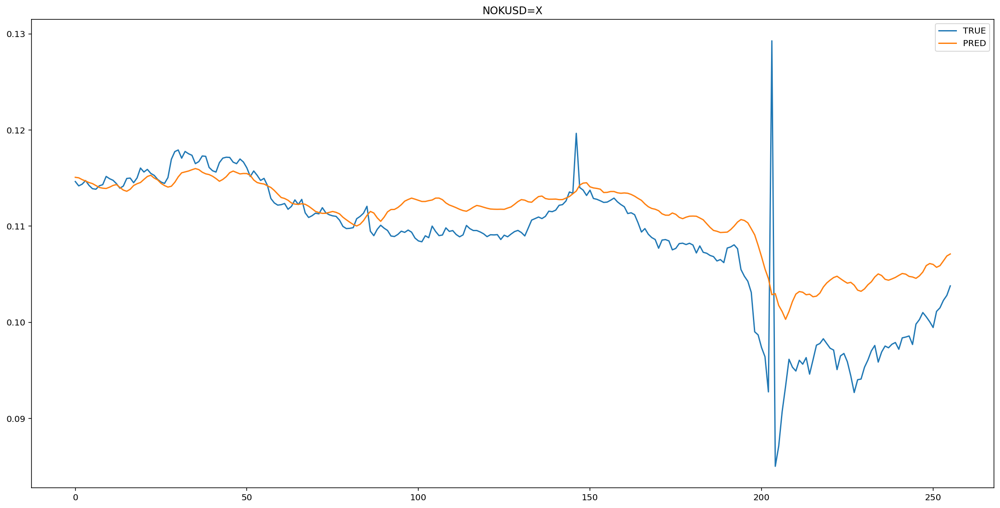

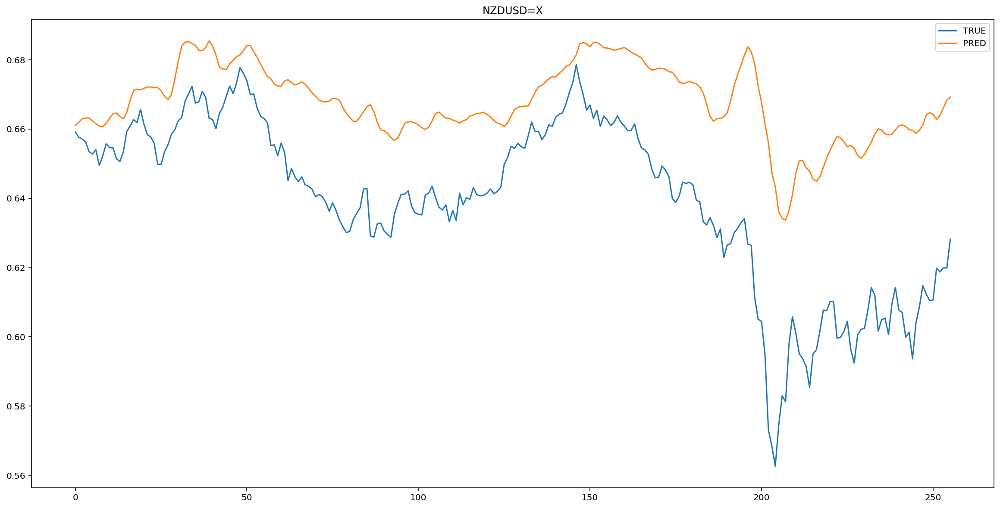

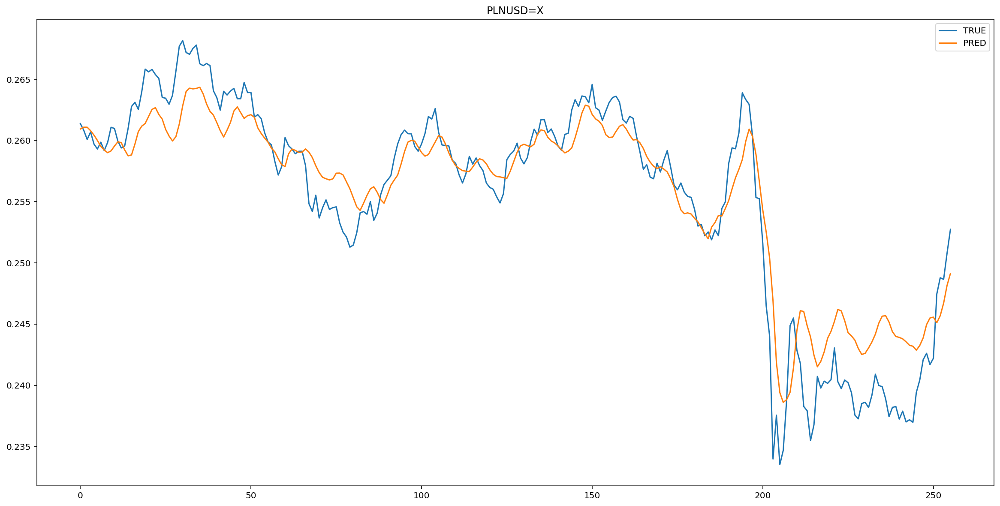

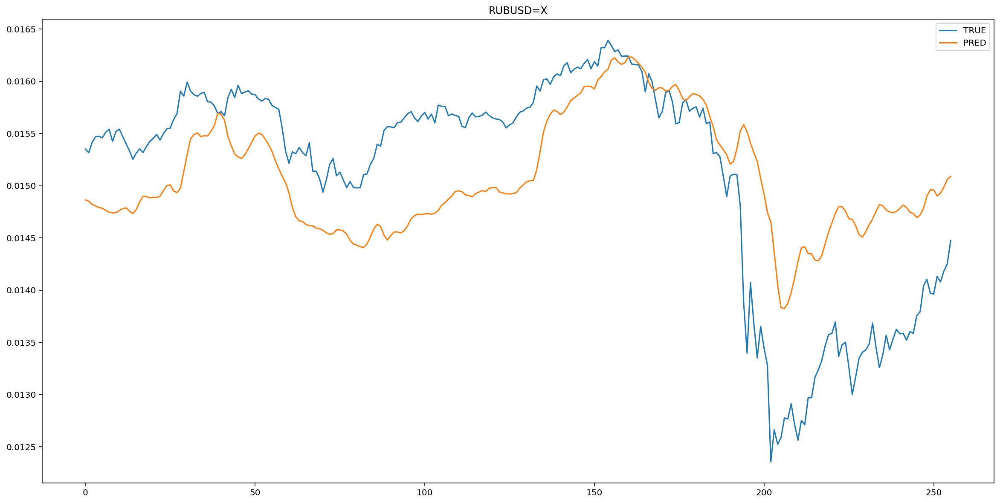

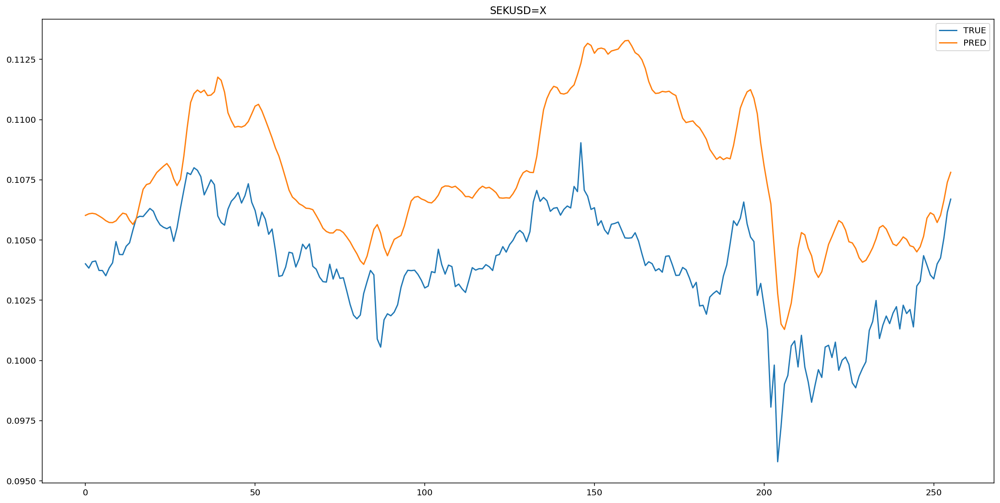

In [ ]:
 for i in range(y_hat.shape[1]):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.title(new_data.columns[i])
    pd.DataFrame(y_hat[:, i],columns=['TRUE']).plot(ax = ax)
    pd.DataFrame(y_pred[:, i],columns=['PRED']).plot(ax = ax)
    plt.show()

Оцениваем точность

####Комбинированные

Оцениваем точность

###Комбинации

####Оцениваем точность

In [ ]:
MSE(y_hat, y_pred)

0.00030682643

In [ ]:
RMSE(y_hat, y_pred)

0.017516462

In [ ]:
MAE(y_hat, y_pred)

0.009553757

#Сравнение

Таблица:

#Версии

In [ ]:
!neofetch

/bin/bash: neofetch: command not found


In [ ]:
!python --version

Python 3.7.10


In [ ]:
!pip freeze
!pip freeze > requirements.txt 

absl-py==0.10.0
alabaster==0.7.12
albumentations==0.1.12
altair==4.1.0
appdirs==1.4.4
argon2-cffi==20.1.0
asgiref==3.3.1
astor==0.8.1
astropy==4.2
astunparse==1.6.3
async-generator==1.10
atari-py==0.2.6
atomicwrites==1.4.0
attrs==20.3.0
audioread==2.1.9
autograd==1.3
Babel==2.9.0
backcall==0.2.0
beautifulsoup4==4.6.3
bleach==3.3.0
blis==0.4.1
bokeh==2.1.1
Bottleneck==1.3.2
branca==0.4.2
bs4==0.0.1
CacheControl==0.12.6
cachetools==4.2.1
catalogue==1.0.0
certifi==2020.12.5
cffi==1.14.5
chainer==7.4.0
chardet==3.0.4
click==7.1.2
cloudpickle==1.3.0
cmake==3.12.0
cmdstanpy==0.9.5
colorlover==0.3.0
community==1.0.0b1
contextlib2==0.5.5
convertdate==2.3.1
coverage==3.7.1
coveralls==0.5
crcmod==1.7
cufflinks==0.17.3
cupy-cuda101==7.4.0
cvxopt==1.2.6
cvxpy==1.0.31
cycler==0.10.0
cymem==2.0.5
Cython==0.29.22
daft==0.0.4
dask==2.12.0
datascience==0.10.6
debugpy==1.0.0
decorator==4.4.2
defusedxml==0.7.1
descartes==1.1.0
dill==0.3.3
distributed==1.25.3
Django==3.1.7
dlib==19.18.0
dm-tree==0.1.5
doc